<a href="https://colab.research.google.com/github/marisanders02/uclamath168networks_finalproject/blob/main/Math168_FinalProjectCode.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

## Analysis of Airport Network in Western United States and Its Implementation for Train Network

In [ ]:
import networkx as nx
import pandas as pd
import matplotlib.pyplot as plt
import numpy as np

In [ ]:
df = pd.read_csv('Airports2.csv')
df = df.sort_values(by='Origin_airport', ascending=True)
df.head()

,Origin_airport,Destination_airport,Origin_city,Destination_city,Passengers,Seats,Flights,Distance,Fly_date,Origin_population,Destination_population,Org_airport_lat,Org_airport_long,Dest_airport_lat,Dest_airport_long
1638828,1B1,BDL,"Hudson, NY","Hartford, CT",1,8,1,58,2009-06-01,61618,1195998,NaN,NaN,41.938900,-72.683197
3373757,ABE,PHL,"Allentown, PA","Philadelphia, PA",276,1100,22,55,2006-01-01,796488,11761824,40.6521,-75.440804,39.871899,-75.241096
1869835,ABE,AVP,"Allentown, PA","Scranton, PA",140,1007,53,50,2006-03-01,796488,547986,40.6521,-75.440804,41.338501,-75.723396
1869834,ABE,AVP,"Allentown, PA","Scranton, PA",66,296,2,50,2006-01-01,796488,547986,40.6521,-75.440804,41.338501,-75.723396
1869833,ABE,AVP,"Allentown, PA","Scranton, PA",0,0,19,50,2006-01-01,796488,547986,40.6521,-75.440804,41.338501,-75.723396


### Data Cleaning & Analysis

In [ ]:
selected_columns = ["Origin_airport", "Destination_airport", "Passengers", "Seats", "Flights", "Distance",
                    "Fly_date", "Org_airport_lat", "Org_airport_long", "Dest_airport_lat", "Dest_airport_long"]
subset_df = df[selected_columns]

#Use the most recent year in the dataset
subset_df['Fly_date'] = subset_df['Fly_date'].astype(str).str[:4]
filtered_df = subset_df[subset_df["Fly_date"] == "2009"]

#Filter such that both origin and destination airports are located in the west coast
air = pd.read_csv("us-airports.csv") #Dataset with state & airport code
air = air.loc[1:, ]

#West Coast: Arizona, California, Nevada, Oregon, Washington, Idaho, Montana, Colorado, New Mexico, Wyoming, Utah
west_coast = air[air["local_region"].isin(["AZ", "CA", "NV", "OR", "WA", "ID", "MT", "CO", "NM", "WY", "UT"])]
west_airport = np.unique(list(west_coast["iata_code"]))
west_df = filtered_df[filtered_df["Origin_airport"].isin(west_airport)]
west_df = west_df[west_df["Destination_airport"].isin(west_airport)]
west_df = west_df.dropna()

<ipython-input-3-aa33ce733cb7>:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  subset_df['Fly_date'] = subset_df['Fly_date'].astype(str).str[:4]


In [ ]:
#Drop military base airports from the dataset
military_bases = ["TCM", "SKA", "SAC", "RIV", "DMA", "HIF", "HMN", "HSH", "LSV", "LUF", "MUO","NJK", "NZY", "NKX"]
west_df = west_df[~west_df[["Origin_airport", "Destination_airport"]].isin(military_bases).any(axis=1)]

#Drop rows of dataset with the same origin and destination airports (self-loops)
west_df = west_df.drop(west_df[west_df['Distance'] == 0].index)

In [ ]:
#Dataset of airport cities household income:
#"Y" if 45% of population has household income $75,000 or higher annually, "N" otherwise
cities = np.unique(west_df[["Origin_airport", "Destination_airport"]])
salaries = ["N", "N", "N", "N", "N", "N", "Y", "N", "N", "N", "N", "N", "Y", "N", "N", "N", "N", "Y", "N", "N",
            "N", "N", "N","Y", "N", "Y", "Y", "N", "N", "N", "N", "N", "Y", "N", "N", "N", "N", "N", "N", "N",
            "N", "N", "Y", "Y","N", "N", "N", "N", "N", "N", "N", "Y", "N", "N", "N", "Y", "Y", "N", "N", "N",
            "N", "N", "Y", "Y", "N", "Y", "Y", "N", "N", "N", "N", "N", "N", "N", "Y", "N", "Y", "Y", "N", "N",
            "Y", "Y", "N", "N", "Y", "Y", "N", "Y", "N", "N", "Y", "N", "Y", "Y", "Y", "N", "Y", "Y", "N", "N",
            "N", "N", "N", "N", "N", "N"]
salary_df = pd.DataFrame({"cities" : cities, "income_dist" : salaries})
salary_df.head()

,cities,income_dist
0,ABQ,N
1,ACV,N
2,ALM,N
3,ALW,N
4,AST,N


In [ ]:
west_df["Dist_km"] = west_df["Distance"] * 1.60934 #Miles to km conversion
west_df.head()

,Origin_airport,Destination_airport,Passengers,Seats,Flights,Distance,Fly_date,Org_airport_lat,Org_airport_long,Dest_airport_lat,Dest_airport_long,Dist_km
270016,ABQ,CVN,146,893,47,205,2009,35.040199,-106.609001,34.425098,-103.079002,329.9147
270018,ABQ,CVN,212,931,49,205,2009,35.040199,-106.609001,34.425098,-103.079002,329.9147
270017,ABQ,CVN,159,893,47,205,2009,35.040199,-106.609001,34.425098,-103.079002,329.9147
270015,ABQ,CVN,157,912,48,205,2009,35.040199,-106.609001,34.425098,-103.079002,329.9147
270014,ABQ,CVN,176,969,51,205,2009,35.040199,-106.609001,34.425098,-103.079002,329.9147


### Network Graph

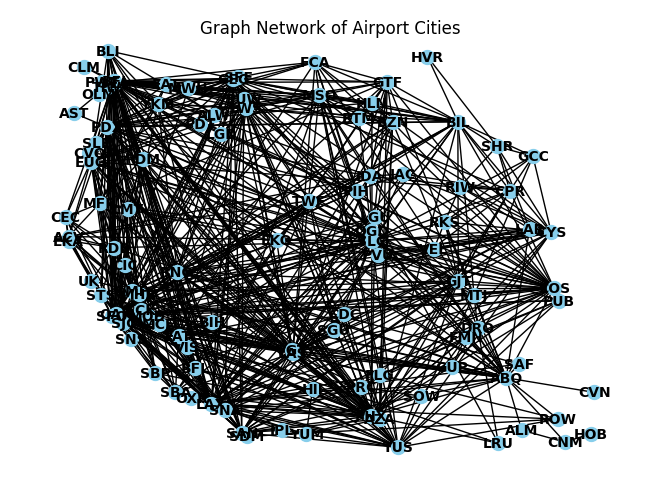

Total CO2 emissions: 111536570316.34355


In [ ]:
G = nx.Graph()
airports = set(pd.concat([west_df["Origin_airport"], west_df["Destination_airport"]]))
G.add_nodes_from(airports)

for index, row in west_df.iterrows():
    origin_airport = row['Origin_airport']
    latitude = row['Org_airport_lat']
    longitude = row['Org_airport_long']
    G.nodes[origin_airport]['latitude'] = latitude
    G.nodes[origin_airport]['longitude'] = longitude

    destination_airport = row['Destination_airport']
    latitude = row['Dest_airport_lat']
    longitude = row['Dest_airport_long']
    G.nodes[destination_airport]['latitude'] = latitude
    G.nodes[destination_airport]['longitude'] = longitude

    passengers = row['Passengers'] * row['Dist_km']
    G.add_edge(origin_airport, destination_airport, weight=passengers * 246)

pos = {node: (G.nodes[node]['longitude'], G.nodes[node]['latitude']) for node in G.nodes}
nx.draw(G, pos, with_labels=True, node_size=100, node_color='skyblue', font_size=10, font_color='black', font_weight='bold')
plt.suptitle("Graph Network of Airport Cities")
plt.show()

total_weight = sum(data['weight'] for _, _, data in G.edges(data=True))
print("Total CO2 emissions:", total_weight)

#### Income Distributions

**Airport Network**: An edge is drawn between airports if at least 45% of the population of the city it is located in has household income of \$75,000 or higher annually.

**Train Network**: An edge is drawn between nodes if less than 45% of the city's population has household income of $75,000 or higher annually.

In [ ]:
def drawNetwork(nodes, type):
  A = nx.Graph()
  A.add_nodes_from(airports)
  for index, row in west_df.iterrows():
    origin = row['Origin_airport']
    latitude = row['Org_airport_lat']
    longitude = row['Org_airport_long']
    A.nodes[origin]['latitude'] = latitude
    A.nodes[origin]['longitude'] = longitude

    destination = row['Destination_airport']
    latitude = row['Dest_airport_lat']
    longitude = row['Dest_airport_long']
    A.nodes[destination]['latitude'] = latitude
    A.nodes[destination]['longitude'] = longitude

    passengers = row["Passengers"] * row["Dist_km"]
    if type == "Airport":
      emission = 246
      if origin in nodes and destination in nodes:
        A.add_edge(origin, destination, weight = passengers * emission)
    elif type == "Train":
      emission = 35
      if origin not in nodes and destination not in nodes:
        A.add_edge(origin, destination, weight = passengers * emission)

  isolates = list(nx.isolates(A))
  A.remove_nodes_from(isolates)
  pos = {node: (A.nodes[node]['longitude'], A.nodes[node]['latitude']) for node in A.nodes}
  nx.draw(A, pos, with_labels=True, node_size=100, node_color='skyblue', font_size=10, font_color='black', font_weight='bold')
  plt.suptitle(type + " Network")
  plt.show()
  x = sum(data['weight'] for _, _, data in A.edges(data=True))
  return x

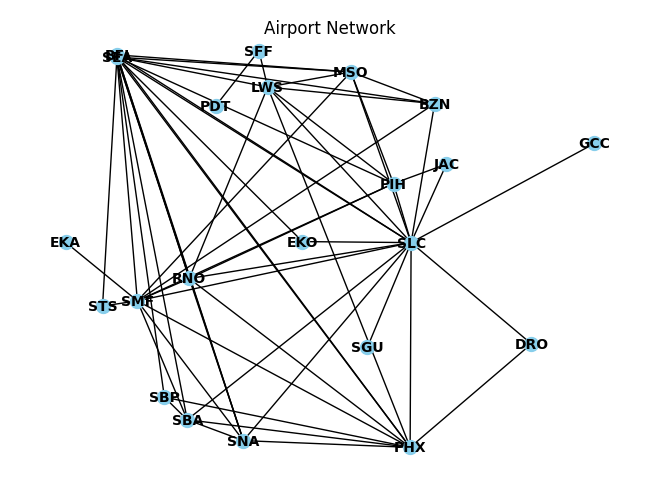

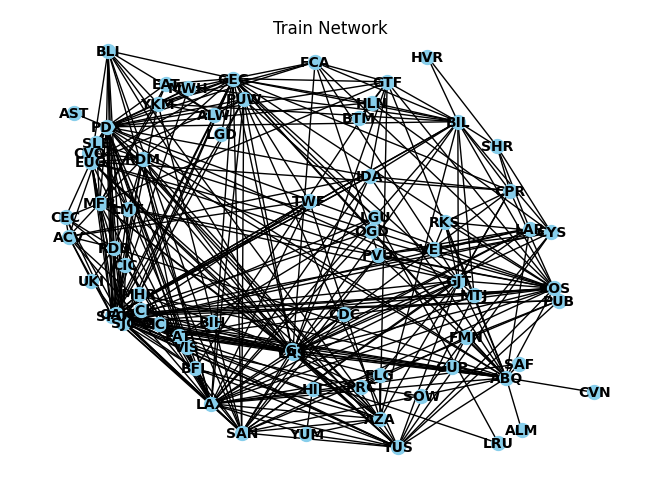

CO2 emissions would be reduced by 78.98636766324006%


In [ ]:
hi_cities = list(salary_df[salary_df.income_dist.values == "Y"].cities)
low_cities = list(salary_df[~salary_df.cities.isin(hi_cities)].cities)

x = drawNetwork(hi_cities, 'Airport')
y = drawNetwork(hi_cities, 'Train')
z = (total_weight - (x + y))/total_weight * 100
print("CO2 emissions would be reduced by", str(z) + "%")

#### Centrality Measures

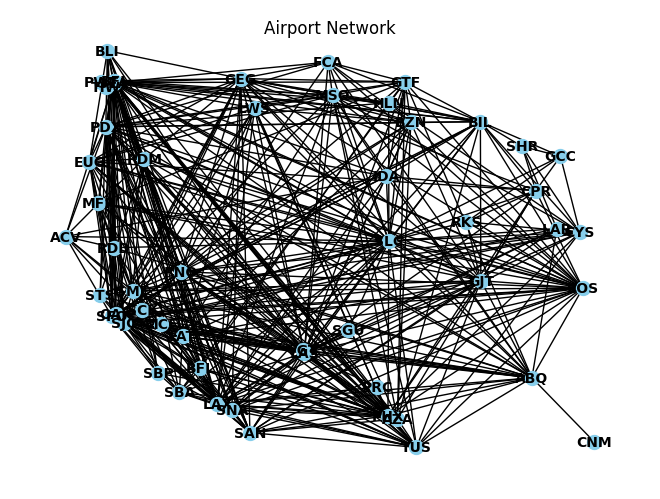

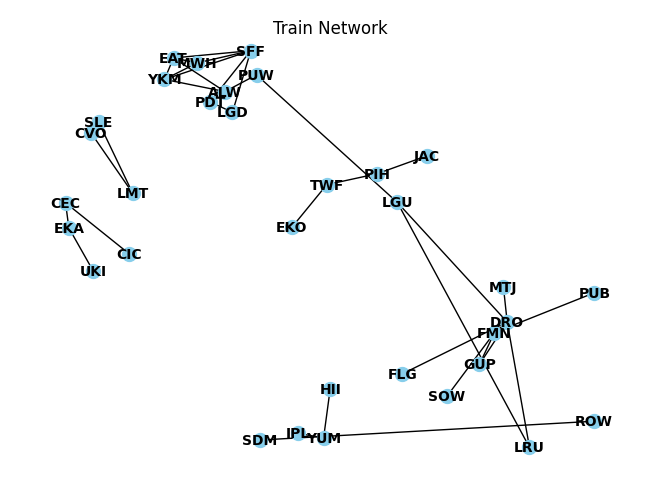

CO2 emissions would be reduced by 3.4721048221480846%


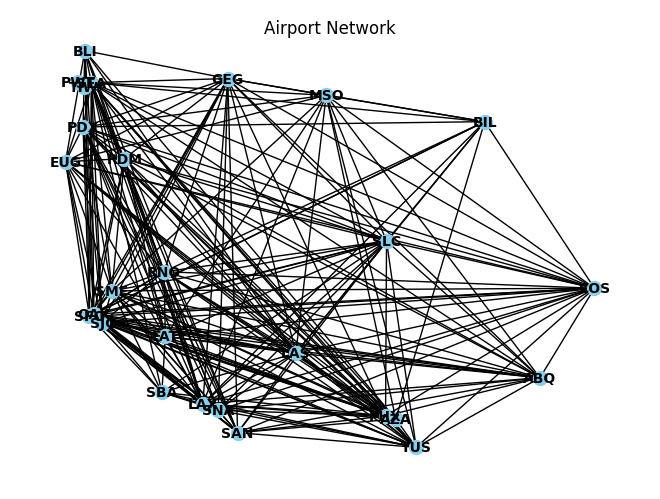

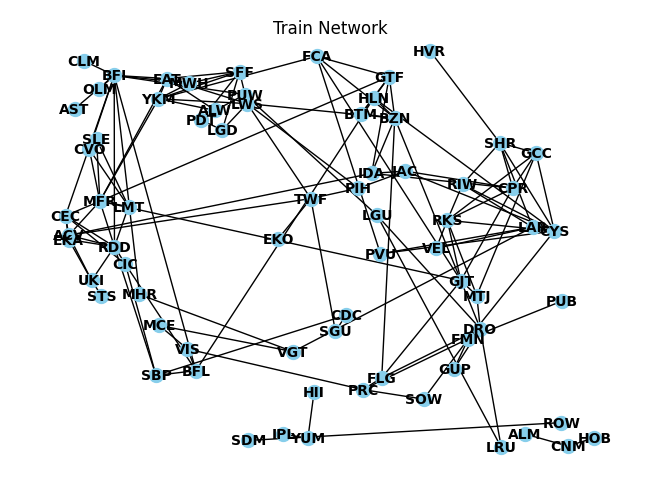

CO2 emissions would be reduced by 19.266171602236916%


In [ ]:
#PageRank Centrality
page_rank = nx.pagerank(G)
pagerank_centrality_array = np.array(list(page_rank.values()))
pr_median = np.median(pagerank_centrality_array)
pr_75 = np.quantile(pagerank_centrality_array, .75)

#median threshold
median_nodes = [node for node, centrality in page_rank.items() if centrality >= pr_median]
x = drawNetwork(median_nodes, 'Airport')
y = drawNetwork(median_nodes, 'Train')
z = (total_weight - (x + y))/total_weight * 100
print("CO2 emissions would be reduced by", str(z) + "%")

#3rd quartile threshold
quart_nodes = [node for node, centrality in page_rank.items() if centrality >= pr_75]
x = drawNetwork(quart_nodes, 'Airport')
y = drawNetwork(quart_nodes, 'Train')
z = (total_weight - (x + y))/total_weight * 100
print("CO2 emissions would be reduced by", str(z) + "%")

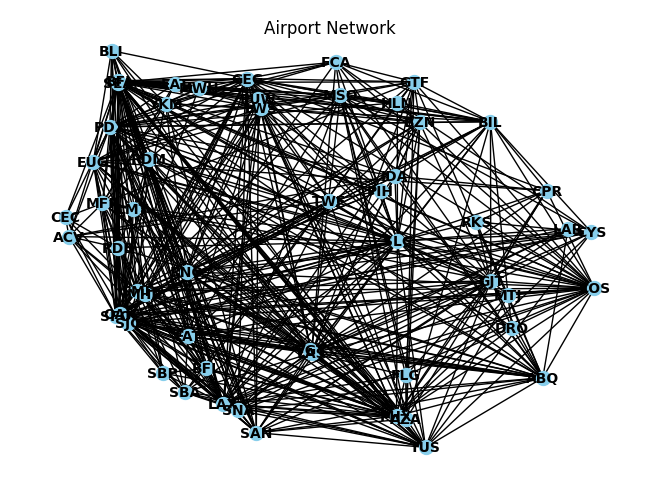

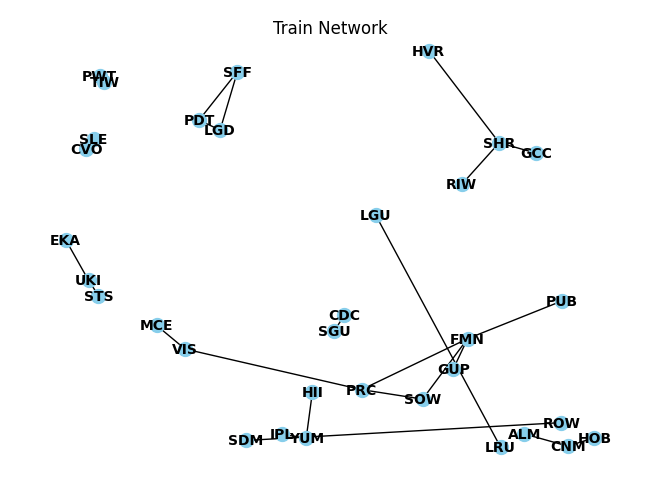

CO2 emissions would be reduced by 4.263504107844578%


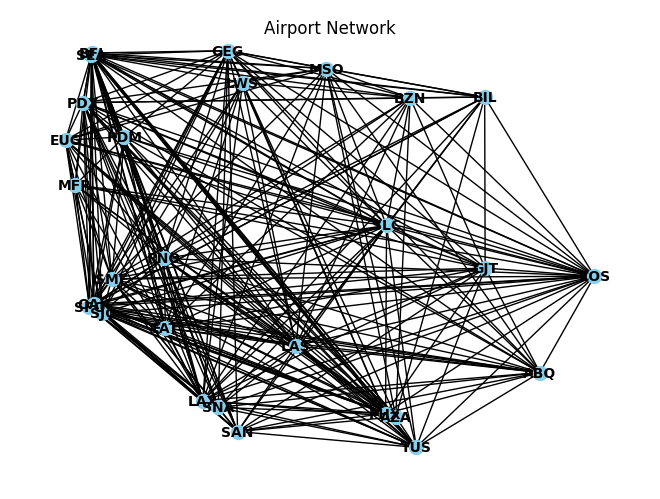

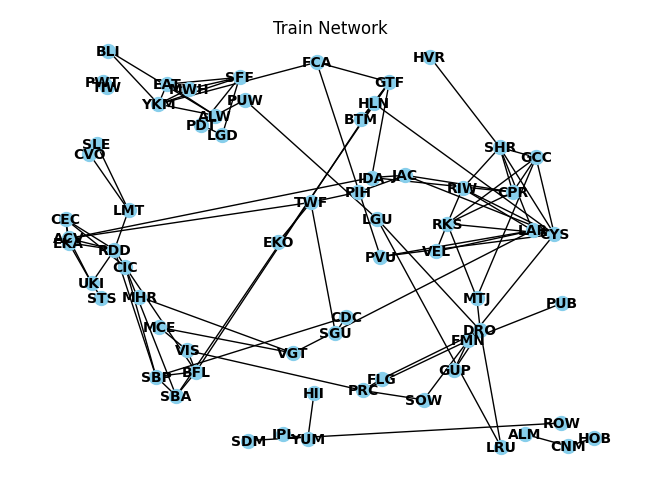

CO2 emissions would be reduced by 19.69203406168341%


In [ ]:
#Degree Centrality
dc = nx.degree_centrality(G)
dc_array = np.array(list(dc.values()))
dc_median = np.median(dc_array)
dc_75 = np.quantile(dc_array, .75)

#median threshold
median_nodes = [node for node, centrality in dc.items() if centrality >= dc_median]
x = drawNetwork(median_nodes, 'Airport')
y = drawNetwork(median_nodes, 'Train')
z = (total_weight - (x + y))/total_weight * 100
print("CO2 emissions would be reduced by", str(z) + "%")

#3rd quartile threshold
quart_nodes = [node for node, centrality in dc.items() if centrality >= dc_75]
x = drawNetwork(quart_nodes, 'Airport')
y = drawNetwork(quart_nodes, 'Train')
z = (total_weight - (x + y))/total_weight * 100
print("CO2 emissions would be reduced by", str(z) + "%")

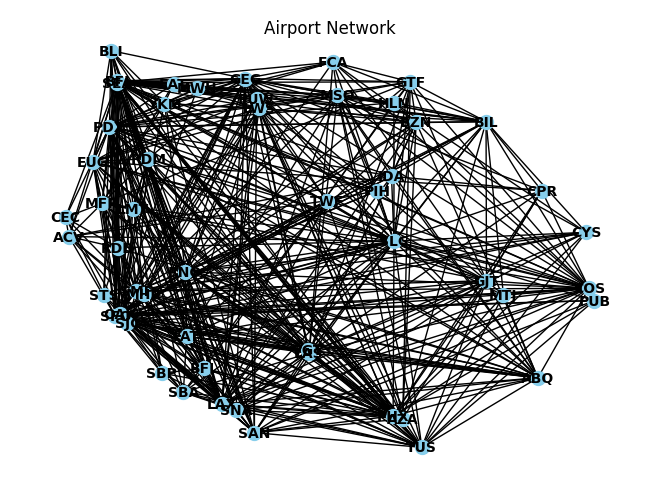

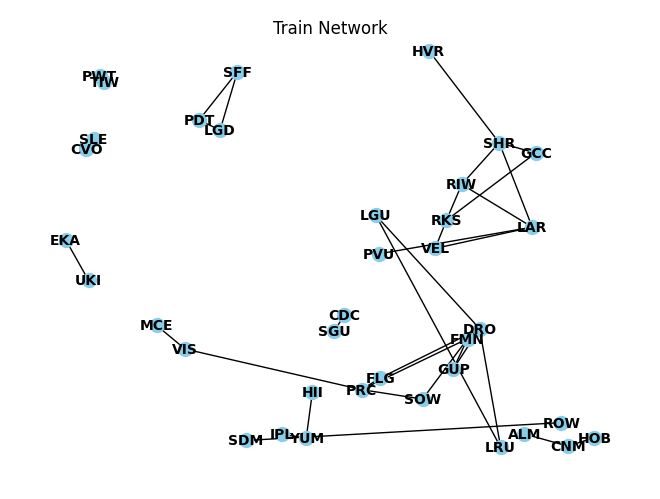

CO2 emissions would be reduced by 3.3268282228734214%


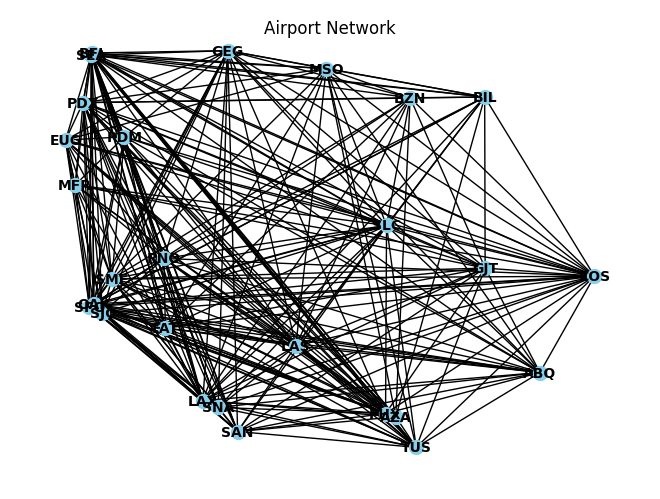

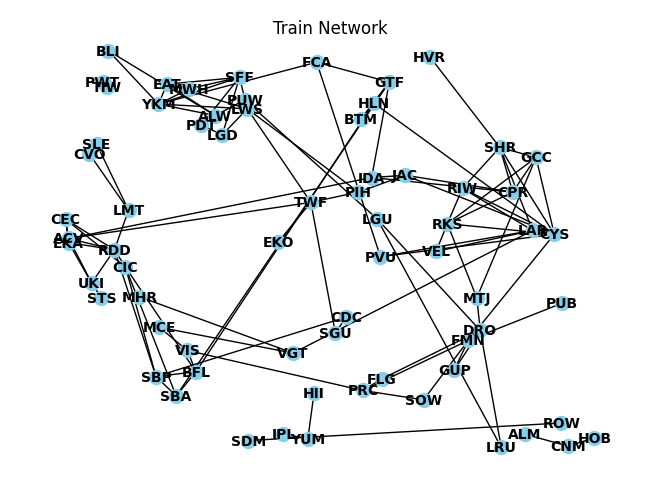

CO2 emissions would be reduced by 20.291923938689823%


In [ ]:
#Eigenvector Centrality
ec = nx.eigenvector_centrality_numpy(G)
ec_array = np.array(list(ec.values()))
ec_median = np.median(ec_array)
ec_75 = np.quantile(ec_array, .75)

#median threshold
median_nodes = [node for node, centrality in ec.items() if centrality >= ec_median]
x = drawNetwork(median_nodes, 'Airport')
y = drawNetwork(median_nodes, 'Train')
z = (total_weight - (x + y))/total_weight * 100
print("CO2 emissions would be reduced by", str(z) + "%")

#3rd quartile threshold
quart_nodes = [node for node, centrality in ec.items() if centrality >= ec_75]
x = drawNetwork(quart_nodes, 'Airport')
y = drawNetwork(quart_nodes, 'Train')
z = (total_weight - (x + y))/total_weight * 100
print("CO2 emissions would be reduced by", str(z) + "%")

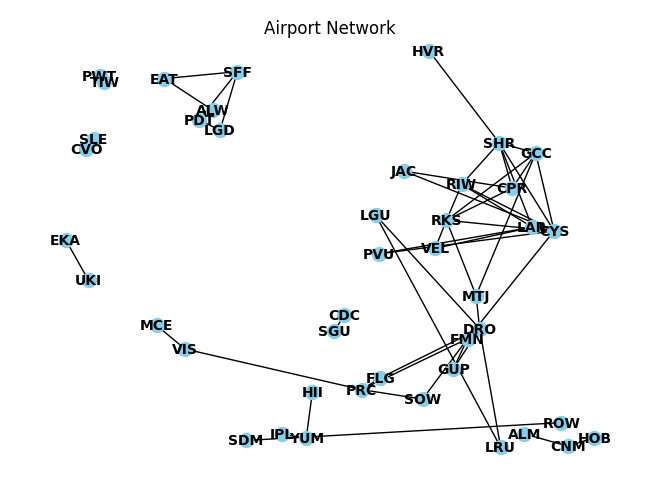

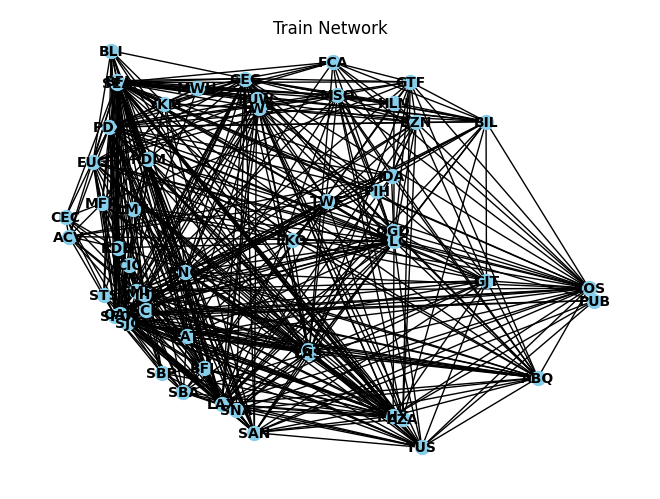

CO2 emissions would be reduced by 86.15756055203703%


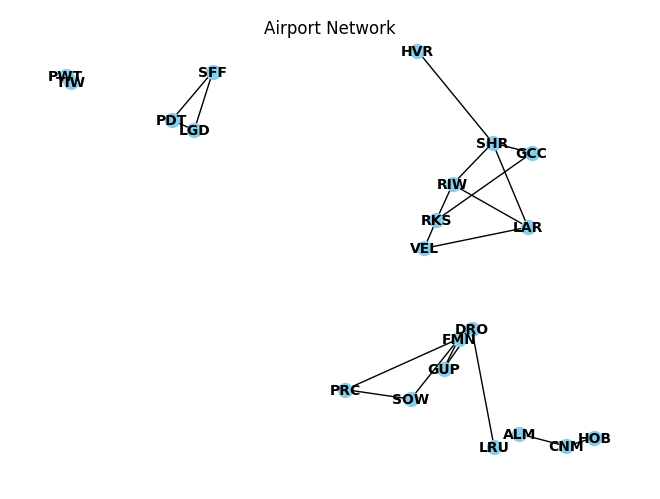

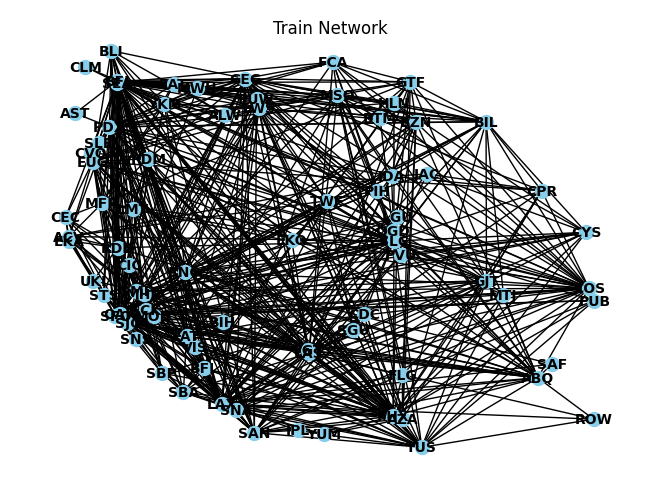

CO2 emissions would be reduced by 85.81736523699013%


In [ ]:
#Katz Centrality
kc = nx.katz_centrality_numpy(G)
kc_array = np.array(list(kc.values()))
kc_median = np.median(kc_array)
kc_75 = np.quantile(kc_array, .75)

#median threshold
median_nodes = [node for node, centrality in kc.items() if centrality >= kc_median]
x = drawNetwork(median_nodes, 'Airport')
y = drawNetwork(median_nodes, 'Train')
z = (total_weight - (x + y))/total_weight * 100
print("CO2 emissions would be reduced by", str(z) + "%")

#3rd quartile threshold
quart_nodes = [node for node, centrality in kc.items() if centrality >= kc_75]
x = drawNetwork(quart_nodes, 'Airport')
y = drawNetwork(quart_nodes, 'Train')
z = (total_weight - (x + y))/total_weight * 100
print("CO2 emissions would be reduced by", str(z) + "%")

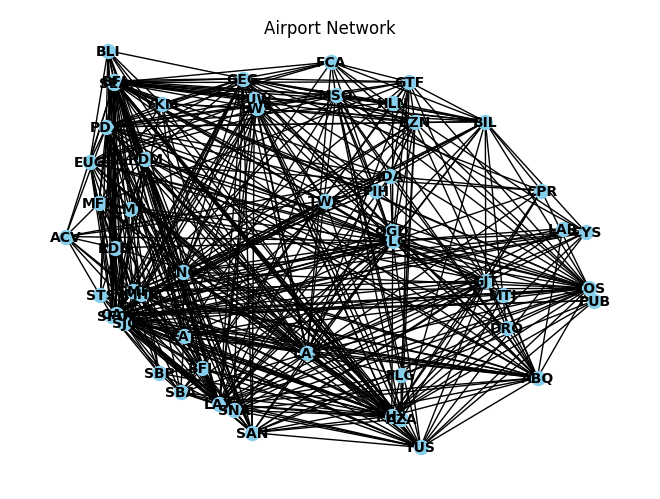

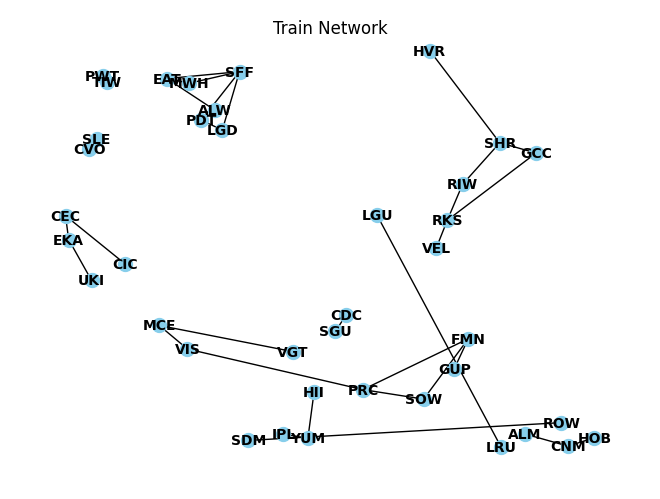

CO2 emissions would be reduced by 3.1709844536104286%


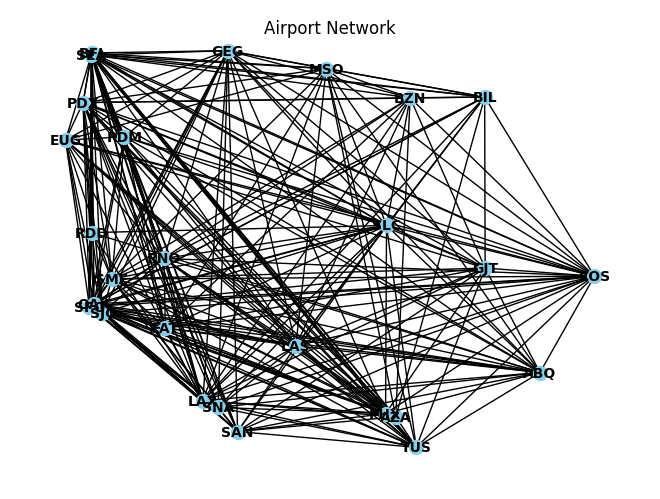

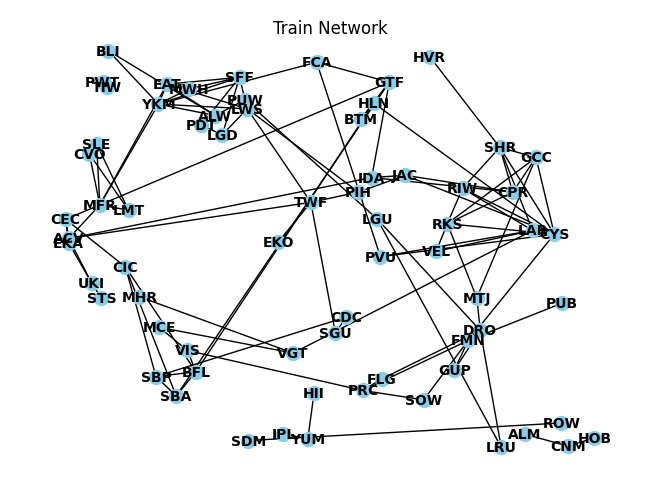

CO2 emissions would be reduced by 21.123841616078863%


In [ ]:
#Closeness Centrality
cc = nx.closeness_centrality(G)
cc_array = np.array(list(cc.values()))
cc_median = np.median(cc_array)
cc_75 = np.quantile(cc_array, .75)

#median threshold
median_nodes = [node for node, centrality in cc.items() if centrality >= cc_median]
x = drawNetwork(median_nodes, 'Airport')
y = drawNetwork(median_nodes, 'Train')
z = (total_weight - (x + y))/total_weight * 100
print("CO2 emissions would be reduced by", str(z) + "%")

#3rd quartile threshold
quart_nodes = [node for node, centrality in cc.items() if centrality >= cc_75]
x = drawNetwork(quart_nodes, 'Airport')
y = drawNetwork(quart_nodes, 'Train')
z = (total_weight - (x + y))/total_weight * 100
print("CO2 emissions would be reduced by", str(z) + "%")

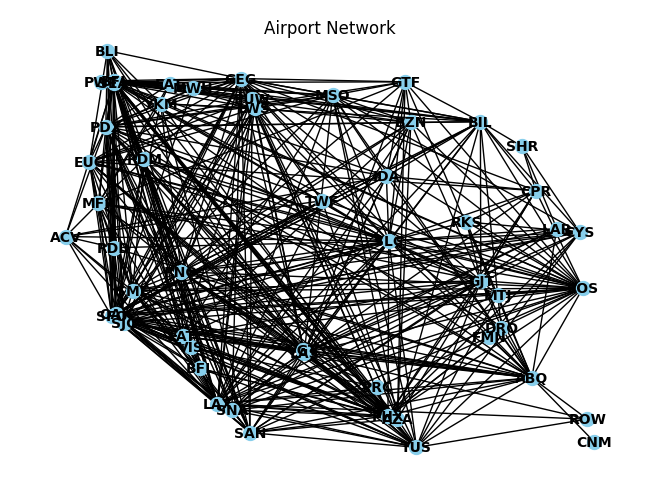

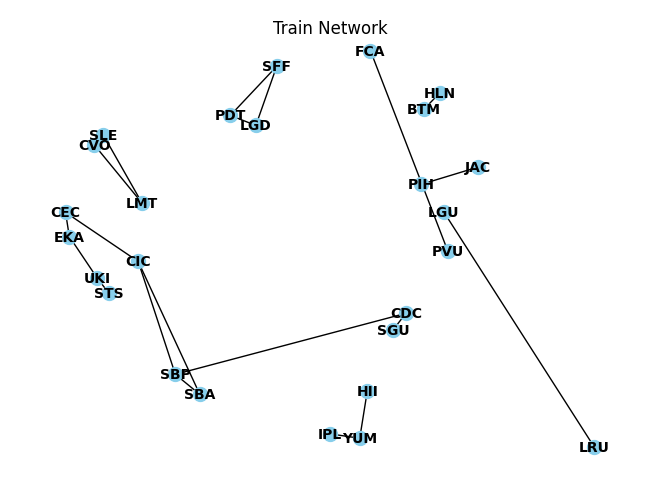

CO2 emissions would be reduced by 9.81110622668277%


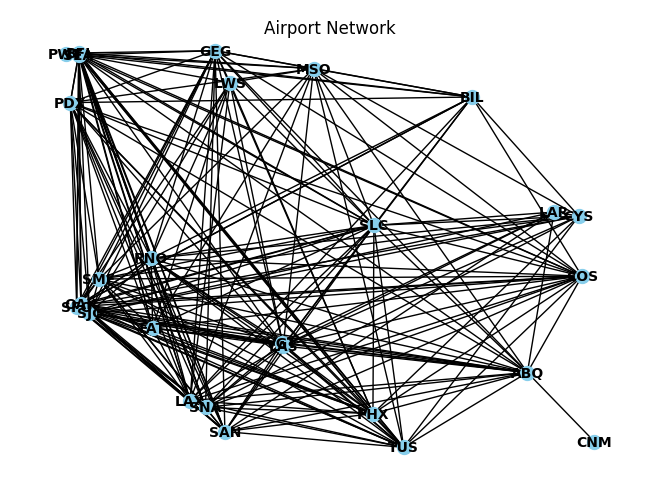

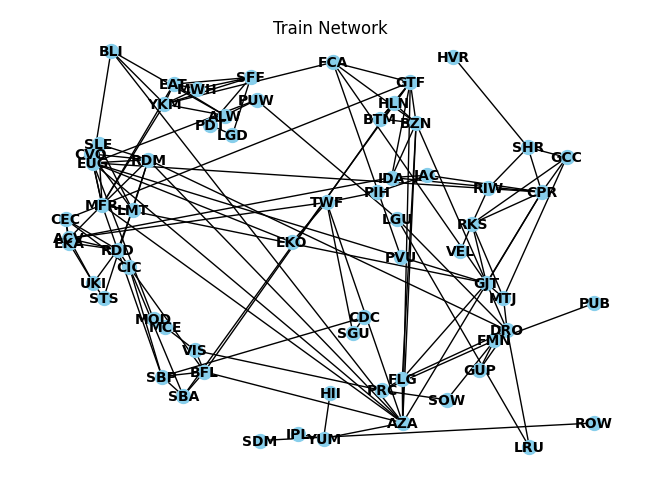

CO2 emissions would be reduced by 28.030060356145487%


In [ ]:
#Betweenness Centrality
bc = nx.betweenness_centrality(G)
bc_array = np.array(list(bc.values()))
bc_median = np.median(bc_array)
bc_75 = np.quantile(bc_array, .75)

#median threshold
median_nodes = [node for node, centrality in bc.items() if centrality >= bc_median]
x = drawNetwork(median_nodes, 'Airport')
y = drawNetwork(median_nodes, 'Train')
z = (total_weight - (x + y))/total_weight * 100
print("CO2 emissions would be reduced by", str(z) + "%")

#3rd quartile threshold
quart_nodes = [node for node, centrality in bc.items() if centrality >= bc_75]
x = drawNetwork(quart_nodes, 'Airport')
y = drawNetwork(quart_nodes, 'Train')
z = (total_weight - (x + y))/total_weight * 100
print("CO2 emissions would be reduced by", str(z) + "%")

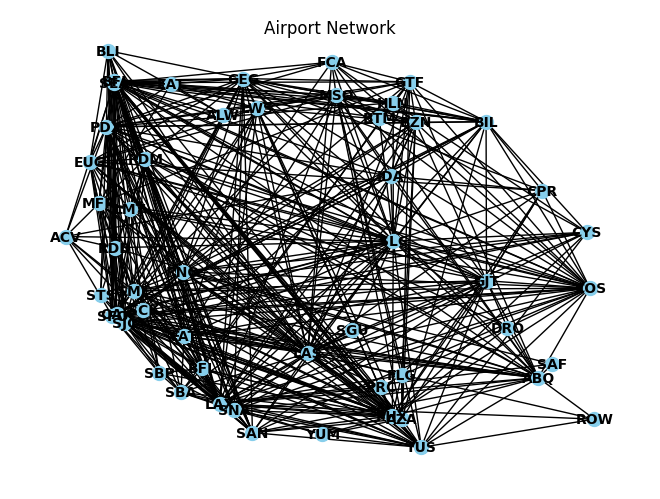

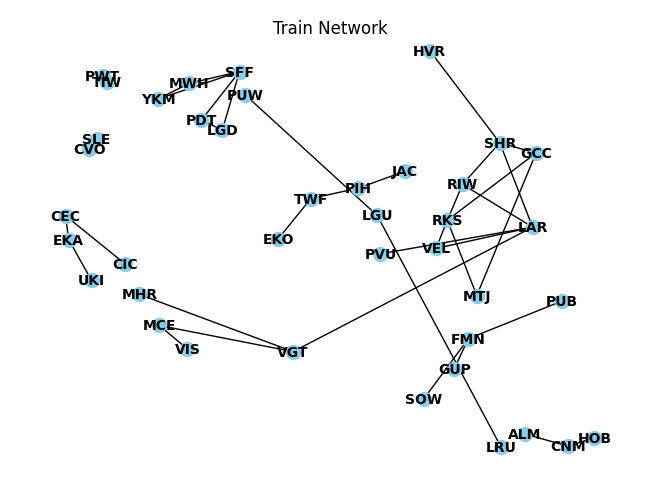

CO2 emissions would be reduced by 2.201907369597328%


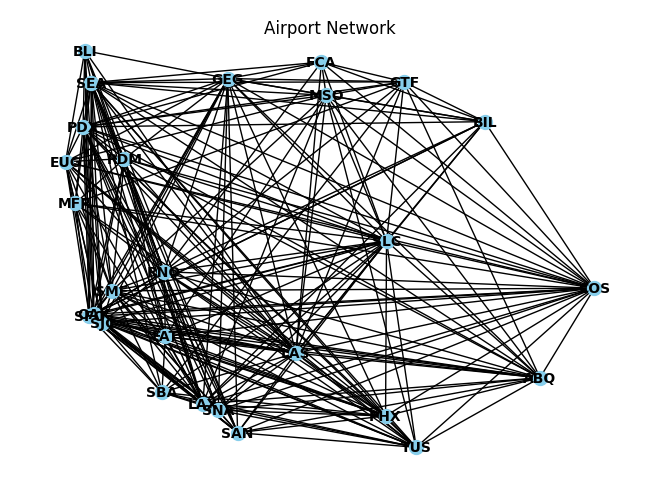

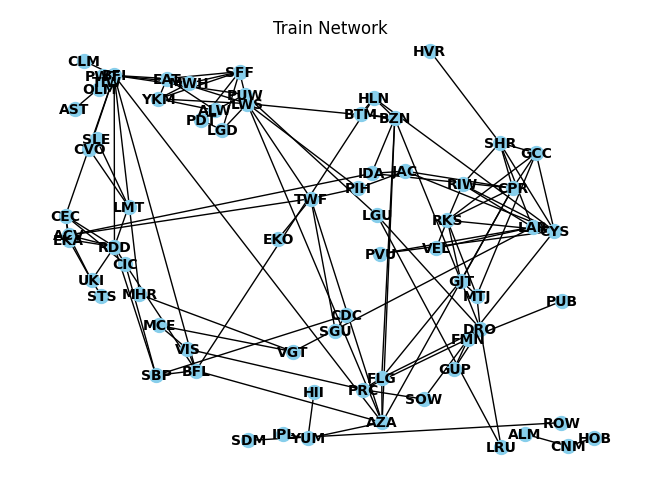

CO2 emissions would be reduced by 17.43279159572835%


In [ ]:
#Laplacian Centrality
lc = nx.laplacian_centrality(G)
lc_array = np.array(list(lc.values()))
lc_median = np.median(lc_array)
lc_75 = np.quantile(lc_array, .75)

#median threshold
median_nodes = [node for node, centrality in lc.items() if centrality >= lc_median]
x = drawNetwork(median_nodes, 'Airport')
y = drawNetwork(median_nodes, 'Train')
z = (total_weight - (x + y))/total_weight * 100
print("CO2 emissions would be reduced by", str(z) + "%")

#3rd quartile threshold
quart_nodes = [node for node, centrality in lc.items() if centrality >= lc_75]
x = drawNetwork(quart_nodes, 'Airport')
y = drawNetwork(quart_nodes, 'Train')
z = (total_weight - (x + y))/total_weight * 100
print("CO2 emissions would be reduced by", str(z) + "%")

#### Income and Centrality Measures

Combining all centrality measures (PageRank, Degree, Eigenvector, Closeness, Betweenness, Laplacian) with income distributions. Katz centrality is not used used due to the impracticality of the train network. Only the third quartile of the centrality measures is used as the threshold.

**Airport Network**: An edge is drawn between airports if at least 45% of the population of the city it is located in has household income of \$75,000 or higher annually OR the centrality measure of the node from the entire airport network is bigger than or equal to the third quartile of all the centrality measures.

**Train Network**: An edge is drawn between nodes if less than 45% of the city's population has household income of $75,000 or higher annually OR the centrality measure of the node from the entire airport network is less than the third quartile of all the centrality measures.

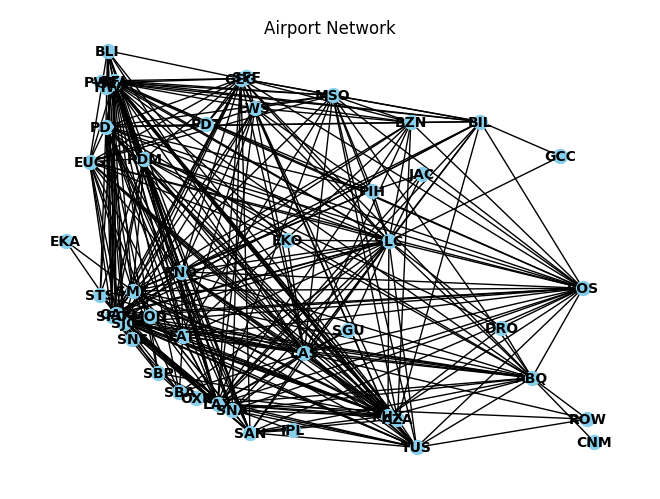

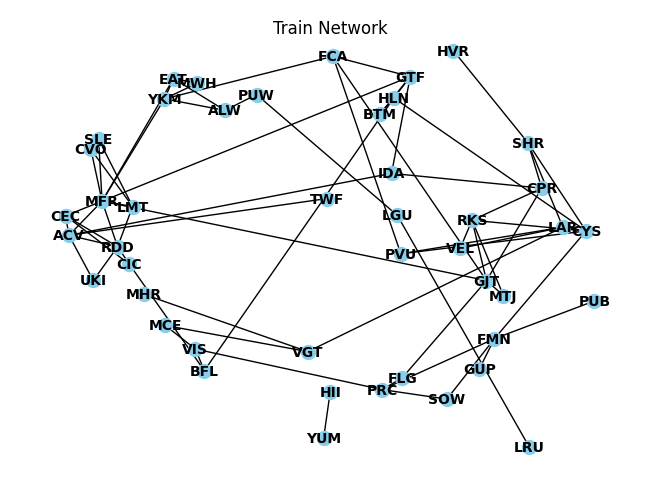

CO2 emissions would be reduced by 14.248990664912334%


In [ ]:
#PageRank Centrality
quart_nodes = [node for node, centrality in page_rank.items() if centrality >= pr_75]
allnode = set.union(set(quart_nodes), set(hi_cities))
x = drawNetwork(allnode, 'Airport')
y = drawNetwork(allnode, 'Train')
z = (total_weight - (x + y))/total_weight * 100
print("CO2 emissions would be reduced by", str(z) + "%")

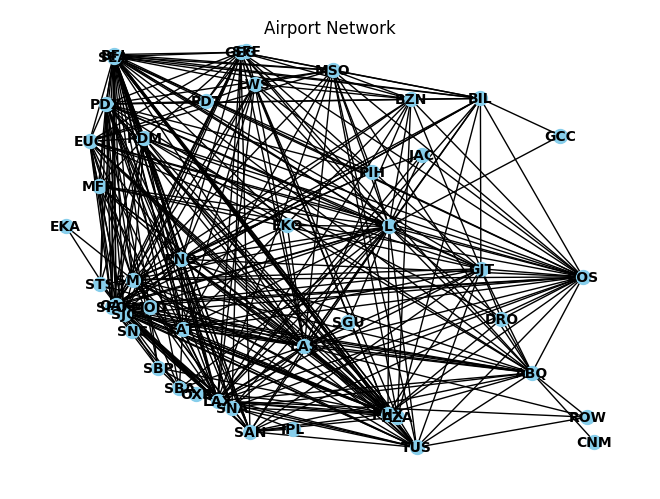

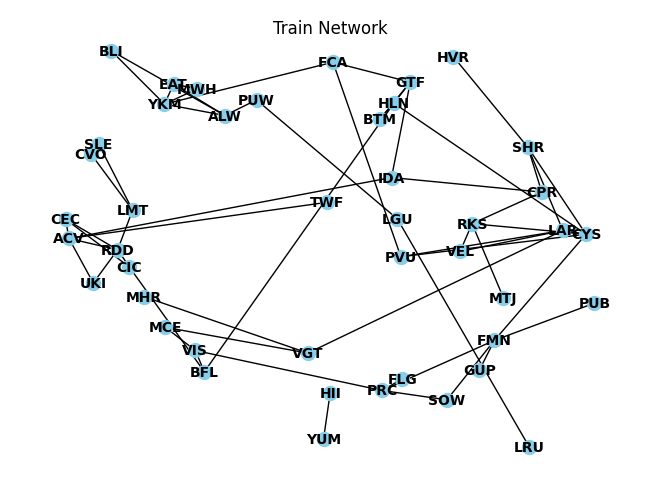

CO2 emissions would be reduced by 14.327200825627957%


In [ ]:
#Degree Centrality
quart_nodes = [node for node, centrality in dc.items() if centrality >= dc_75]
allnode = set.union(set(quart_nodes), set(hi_cities))
x = drawNetwork(allnode, 'Airport')
y = drawNetwork(allnode, 'Train')
z = (total_weight - (x + y))/total_weight * 100
print("CO2 emissions would be reduced by", str(z) + "%")

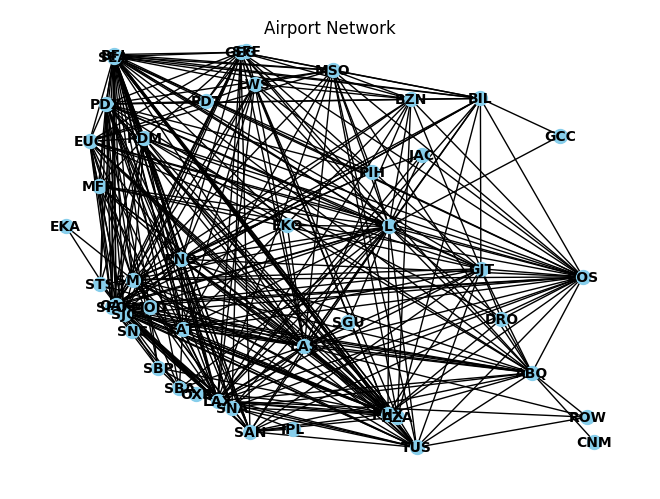

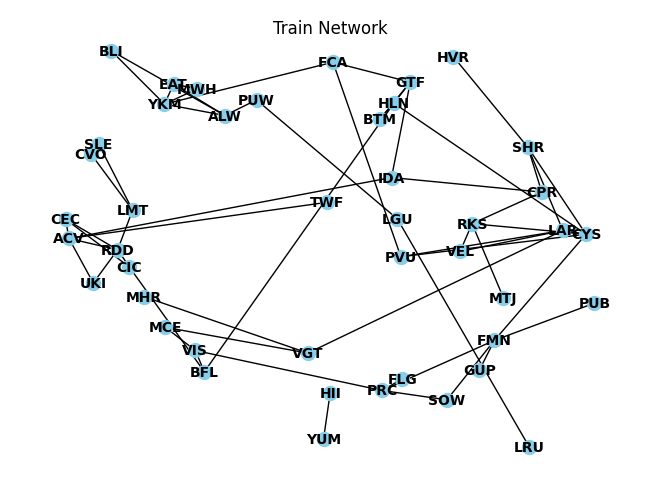

CO2 emissions would be reduced by 14.327200825627957%


In [ ]:
#Eigenvector Centrality
quart_nodes = [node for node, centrality in ec.items() if centrality >= ec_75]
allnode = set.union(set(quart_nodes), set(hi_cities))
x = drawNetwork(allnode, 'Airport')
y = drawNetwork(allnode, 'Train')
z = (total_weight - (x + y))/total_weight * 100
print("CO2 emissions would be reduced by", str(z) + "%")

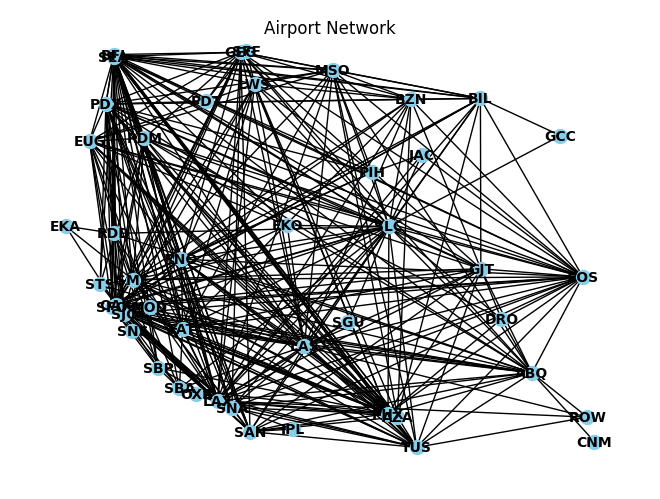

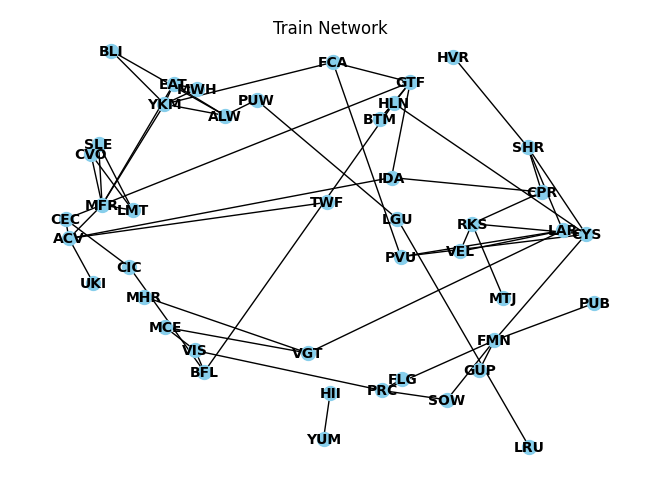

CO2 emissions would be reduced by 15.15911850301701%


In [ ]:
#Closeness Centrality
quart_nodes = [node for node, centrality in cc.items() if centrality >= cc_75]
allnode = set.union(set(quart_nodes), set(hi_cities))
x = drawNetwork(allnode, 'Airport')
y = drawNetwork(allnode, 'Train')
z = (total_weight - (x + y))/total_weight * 100
print("CO2 emissions would be reduced by", str(z) + "%")

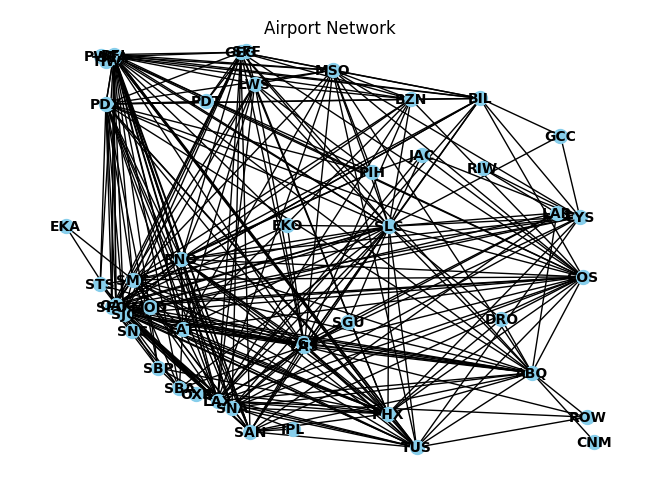

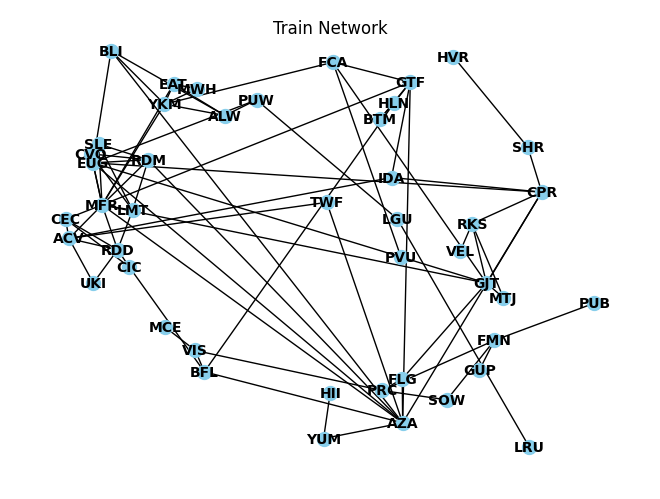

CO2 emissions would be reduced by 21.53196205559279%


In [ ]:
#Betweenness Centrality
quart_nodes = [node for node, centrality in bc.items() if centrality >= bc_75]
allnode = set.union(set(quart_nodes), set(hi_cities))
x = drawNetwork(allnode, 'Airport')
y = drawNetwork(allnode, 'Train')
z = (total_weight - (x + y))/total_weight * 100
print("CO2 emissions would be reduced by", str(z) + "%")

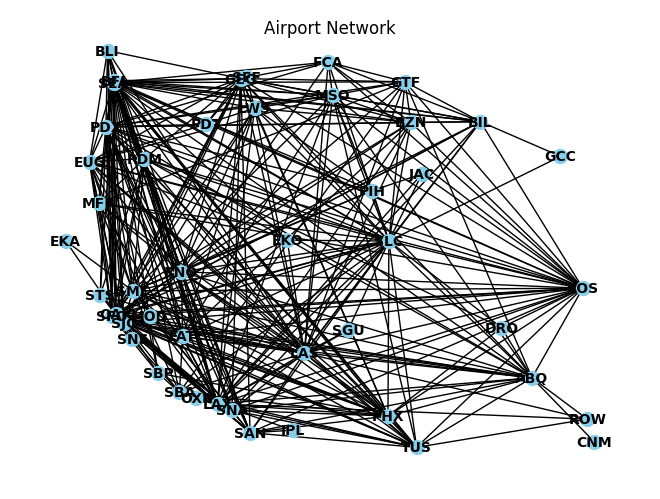

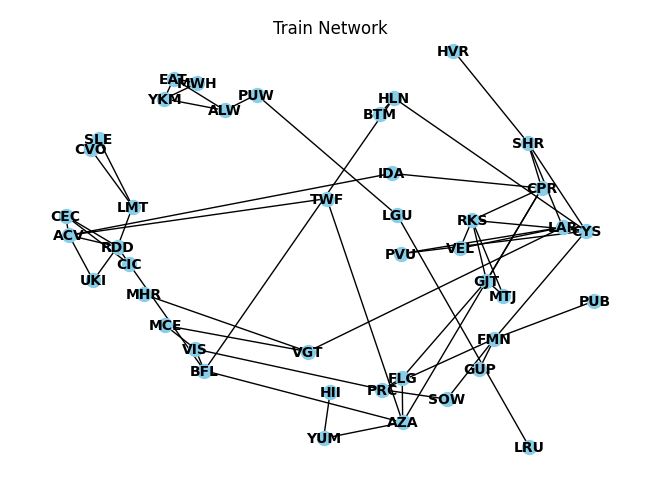

CO2 emissions would be reduced by 12.474104937955687%


In [ ]:
#Laplacian Centrality
quart_nodes = [node for node, centrality in lc.items() if centrality >= lc_75]
allnode = set.union(set(quart_nodes), set(hi_cities))
x = drawNetwork(allnode, 'Airport')
y = drawNetwork(allnode, 'Train')
z = (total_weight - (x + y))/total_weight * 100
print("CO2 emissions would be reduced by", str(z) + "%")

#### Distance Measures

**Airport Network**: An edge is drawn between airports if the flight distance is greater than or equal to the threshold.

**Train Network**: An edge is drawn between nodes if distance is less than the threshold.

In [ ]:
def drawNetworkDistance(threshold):
  traindf = west_df.loc[west_df["Distance"] < threshold]
  trains = set(pd.concat([traindf["Origin_airport"], traindf["Destination_airport"]]))
  TDist = nx.Graph()
  TDist.add_nodes_from(trains)

  for index, row in traindf.iterrows():
    origin_airport = row['Origin_airport']
    latitude = row['Org_airport_lat']
    longitude = row['Org_airport_long']
    TDist.nodes[origin_airport]['latitude'] = latitude
    TDist.nodes[origin_airport]['longitude'] = longitude

    destination_airport = row['Destination_airport']
    latitude = row['Dest_airport_lat']
    longitude = row['Dest_airport_long']
    TDist.nodes[destination_airport]['latitude'] = latitude
    TDist.nodes[destination_airport]['longitude'] = longitude

    passengers = row['Passengers'] * row["Dist_km"]
    TDist.add_edge(origin_airport, destination_airport, weight = passengers * 35)

  pos = {node: (TDist.nodes[node]['longitude'], TDist.nodes[node]['latitude']) for node in TDist.nodes}
  nx.draw(TDist, pos, with_labels=True, node_size=100, node_color='skyblue', font_size=10, font_color='black', font_weight='bold')
  plt.suptitle("Train Network for Cities with Distance < " + str(threshold) + " Miles")
  plt.show()

  ADist = G.copy()
  for i in list(TDist.edges()):
    ADist.remove_edge(*i)
  isolates = list(nx.isolates(ADist))
  ADist.remove_nodes_from(isolates)
  pos = {node: (ADist.nodes[node]['longitude'], ADist.nodes[node]['latitude']) for node in ADist.nodes}
  nx.draw(ADist, pos, with_labels=True, node_size=100, node_color='skyblue', font_size=10, font_color='black', font_weight='bold')
  plt.suptitle("Airport Network for Cities with Distance >= " + str(threshold) + " Miles")
  plt.show()

  x = sum(data['weight'] for _, _, data in TDist.edges(data=True))
  y = sum(data['weight'] for _, _, data in ADist.edges(data=True))
  return TDist, ADist, x, y

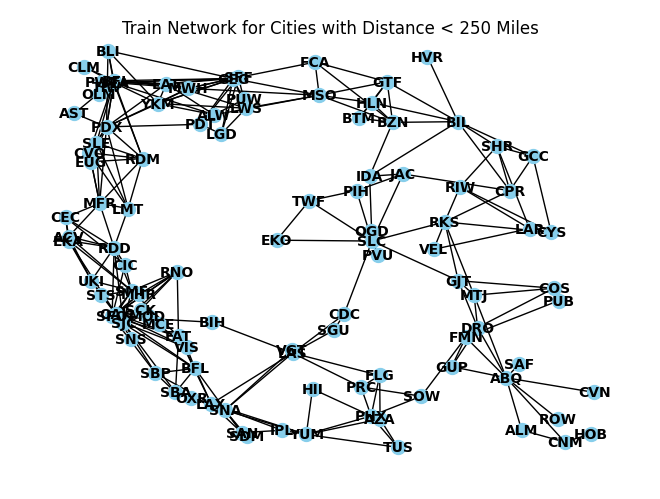

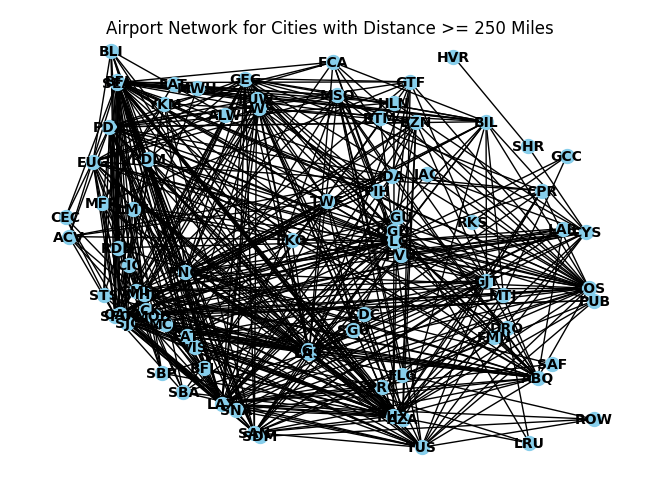

CO2 emissions would be reduced by 3.615453009500918%


In [ ]:
TDist1, ADist1, x1, y1 = drawNetworkDistance(250)
z = (total_weight - (x1 + y1))/total_weight * 100
print("CO2 emissions would be reduced by", str(z) + "%")

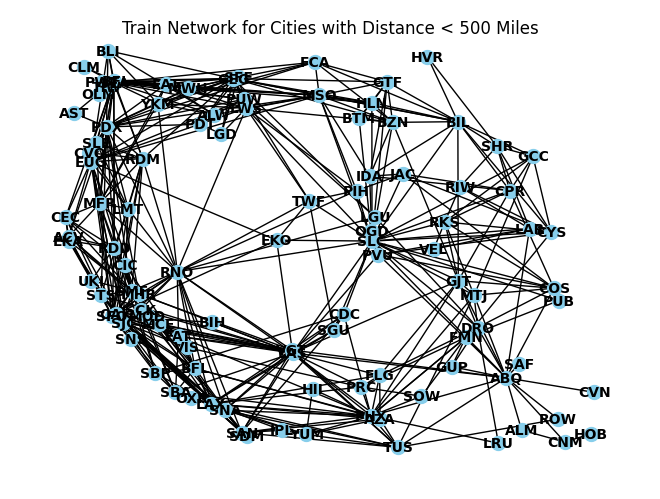

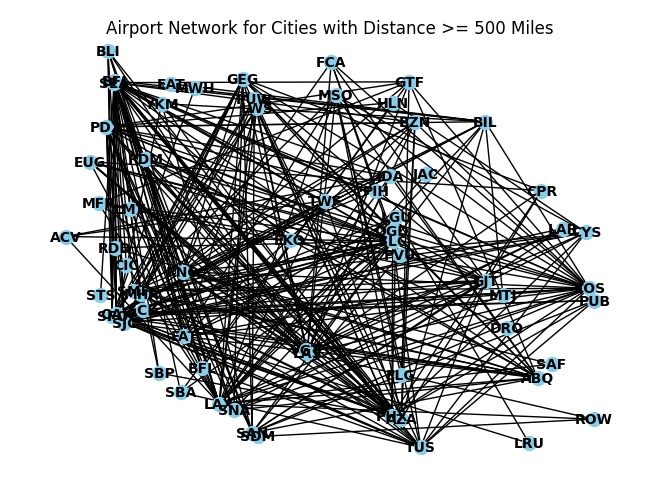

CO2 emissions would be reduced by 32.958900989783025%


In [ ]:
TDist2, ADist2, x2, y2 = drawNetworkDistance(500)
z = (total_weight - (x2 + y2))/total_weight * 100
print("CO2 emissions would be reduced by", str(z) + "%")

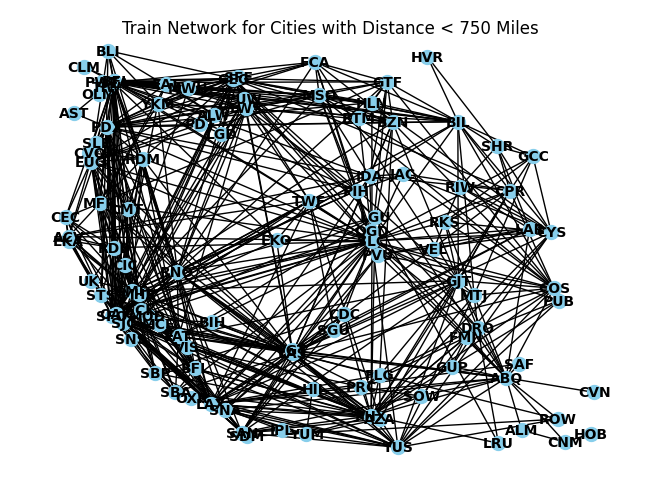

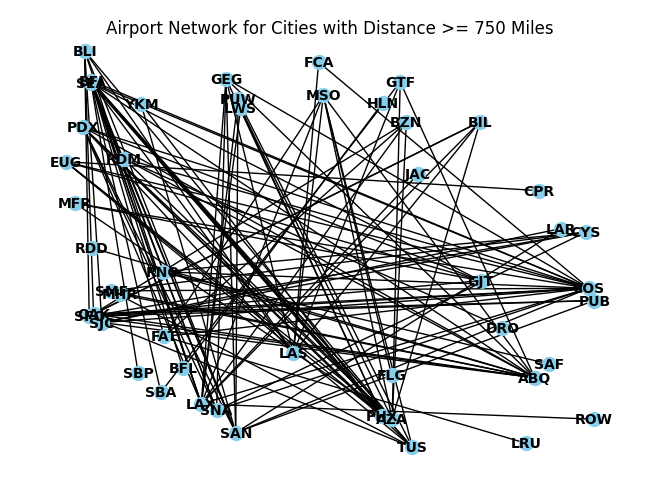

CO2 emissions would be reduced by 60.22618299325389%


In [ ]:
TDist3, ADist3, x3, y3 = drawNetworkDistance(750)
z = (total_weight - (x3 + y3))/total_weight * 100
print("CO2 emissions would be reduced by", str(z) + "%")

#### Distance, Income & Centrality Measures

Since PageRank, Degree, and Eigenvector centrality combined with income results in relatively equal amount of reduction in CO2 emissions, only PageRank is used among the three. Laplacian centrality is not used since the reduction of CO2 emission is relatively low compared to other measures of centralities combined with income. Therefore PageRank, Closeness, and Betweenness centrality with the third quartile of the centrality measures are used as the threshold.

**Airport Network**: An edge is drawn between airports if the flight distance is greater than or equal to the threshold, the centrality of the node in train network is less than the third quartile, or at least 45% of the city population has household income of \$75,000 or higher annually.

**Train Network**: An edge is drawn between nodes if distance is less than the threshold, the centrality of the node in train network is higher than or equal to the third quartile, or less than 45% of the city's population has household income of $75,000 or higher annually.

In [ ]:
def drawNetworkDIC(Train, dist, centrality_func):
  a = centrality_func(Train)
  arr = np.array(list(a.values()))
  a_75 = np.quantile(arr, .75)

  nodes = [node for node, centrality in a.items() if centrality >= a_75]
  nodes = set.union(set(nodes), set(low_cities))

  for i in a:
    if i not in nodes:
      Train.remove_node(i)
  isolates = list(nx.isolates(Train))
  Train.remove_nodes_from(isolates)
  pos = {node: (Train.nodes[node]['longitude'], Train.nodes[node]['latitude']) for node in Train.nodes}
  nx.draw(Train, pos, with_labels=True, node_size=100, node_color='skyblue', font_size=10, font_color='black', font_weight='bold')
  plt.suptitle("Train Network with Distance " + str(dist) + " miles, Income & Centrality Measures")
  plt.show()

  Airport = G.copy()
  for i in list(Train.edges()):
    Airport.remove_edge(*i)
  isolates = list(nx.isolates(Airport))
  Airport.remove_nodes_from(isolates)
  pos = {node: (Airport.nodes[node]['longitude'], Airport.nodes[node]['latitude']) for node in Airport.nodes}
  nx.draw(Airport, pos, with_labels=True, node_size=100, node_color='skyblue', font_size=10, font_color='black', font_weight='bold')
  plt.suptitle("Airport Network with Distance " + str(dist) + " miles, Income & Centrality Measures")
  plt.show()

  x = sum(data['weight'] for _, _, data in Train.edges(data=True))
  y = sum(data['weight'] for _, _, data in Airport.edges(data=True))
  return Train, x, y

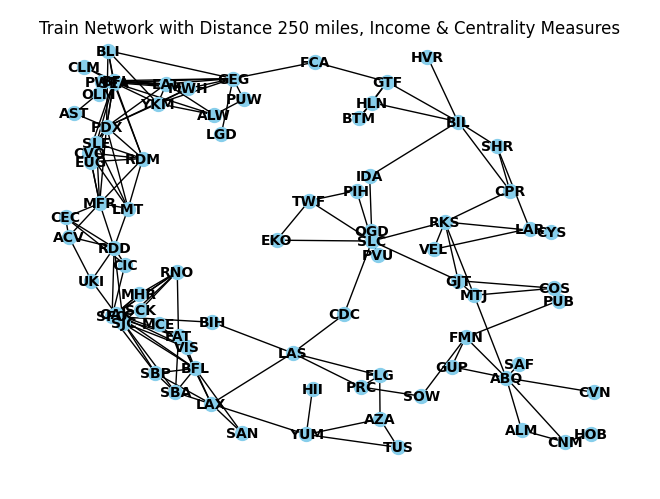

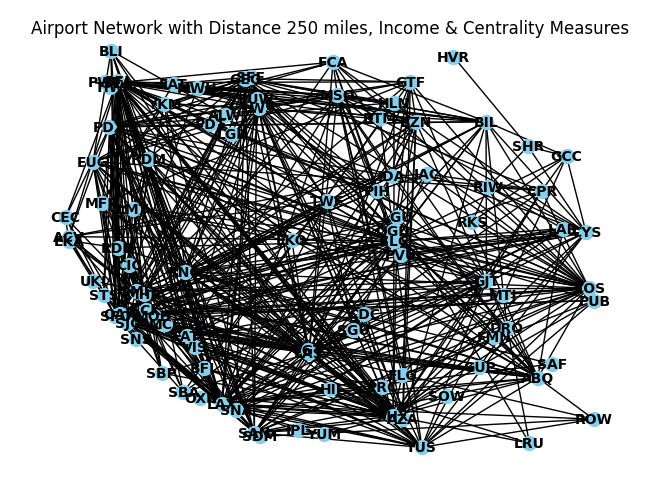

CO2 emissions would be reduced by 3.2205545588021613%


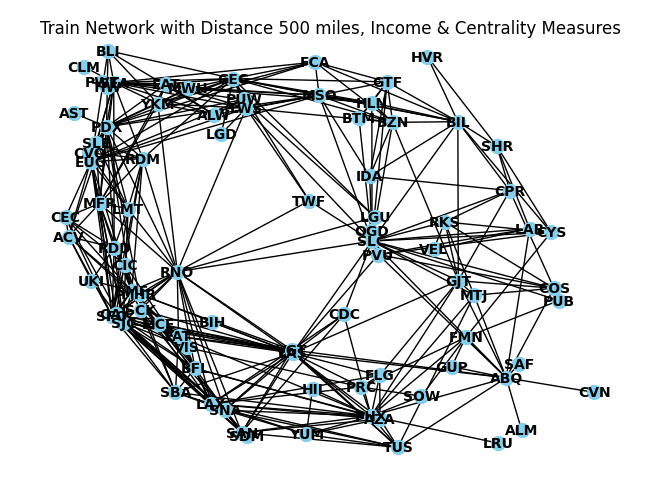

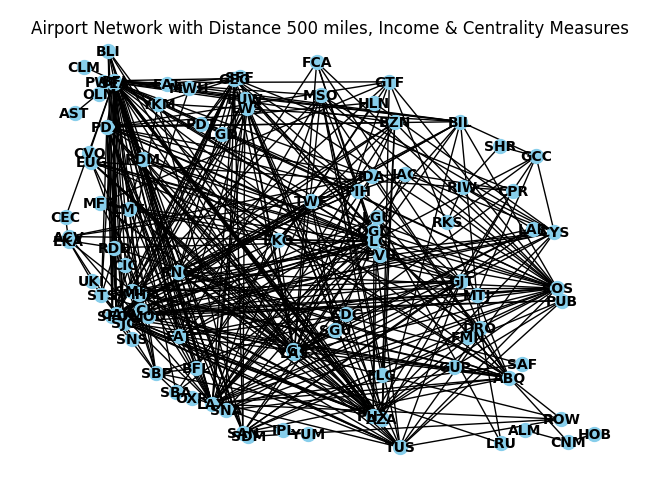

CO2 emissions would be reduced by 30.87919123947904%


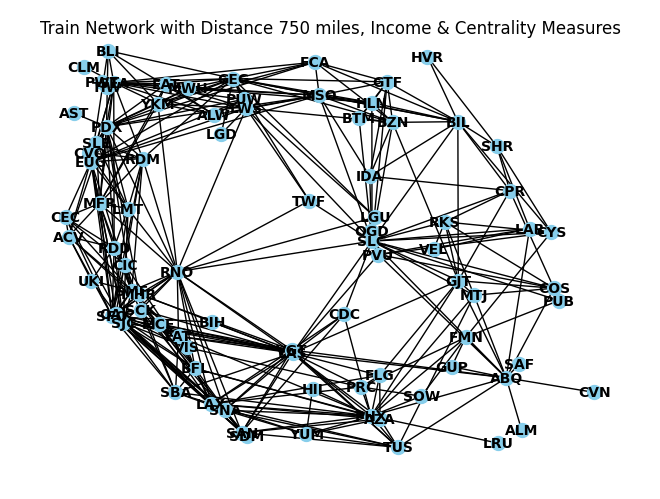

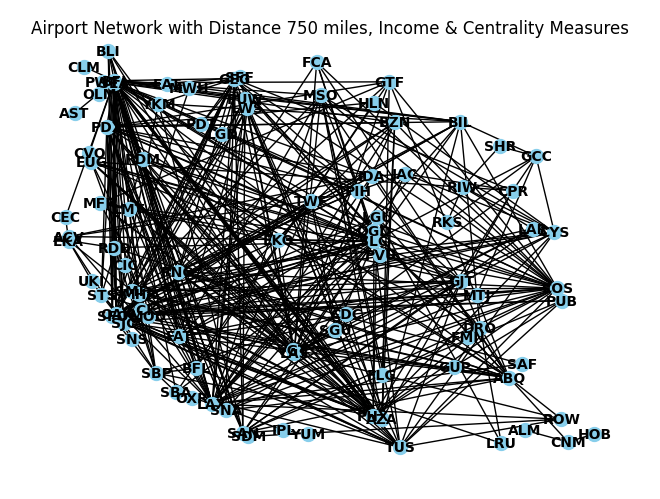

CO2 emissions would be reduced by 30.87919123947904%


In [ ]:
#PageRank Centrality
T1 = TDist1.copy()
T1, x, y = drawNetworkDIC(T1, 250, nx.pagerank)
z = (total_weight - (x + y))/total_weight * 100
print("CO2 emissions would be reduced by", str(z) + "%")

T2 = TDist2.copy()
T2, x, y = drawNetworkDIC(T2, 500, nx.pagerank)
z = (total_weight - (x + y))/total_weight * 100
print("CO2 emissions would be reduced by", str(z) + "%")

T3 = TDist2.copy()
T3, x, y = drawNetworkDIC(T3, 750, nx.pagerank)
z = (total_weight - (x + y))/total_weight * 100
print("CO2 emissions would be reduced by", str(z) + "%")

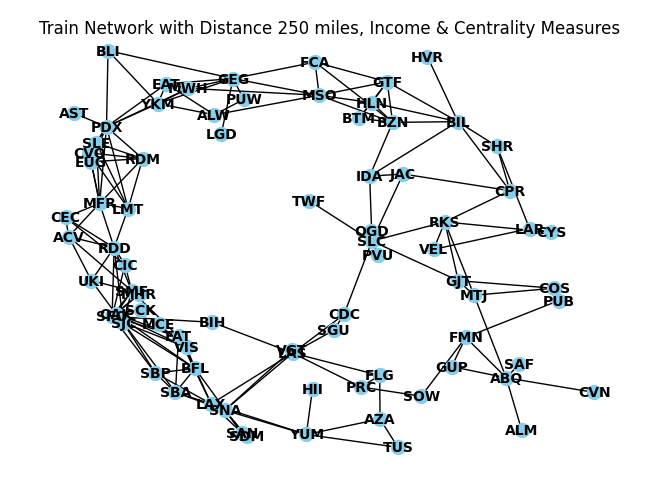

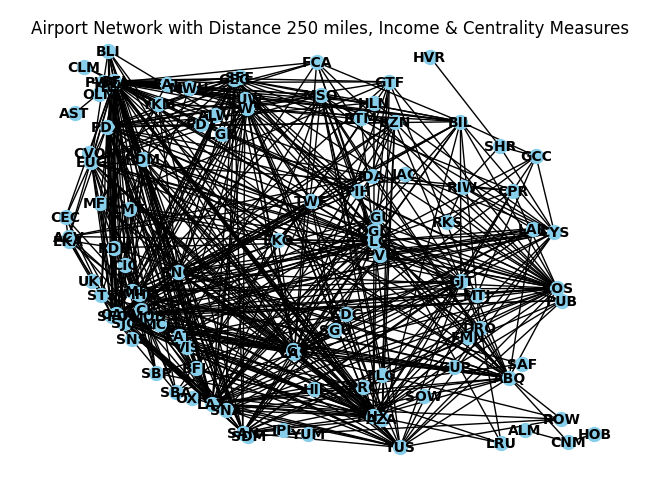

CO2 emissions would be reduced by 2.334528375785766%


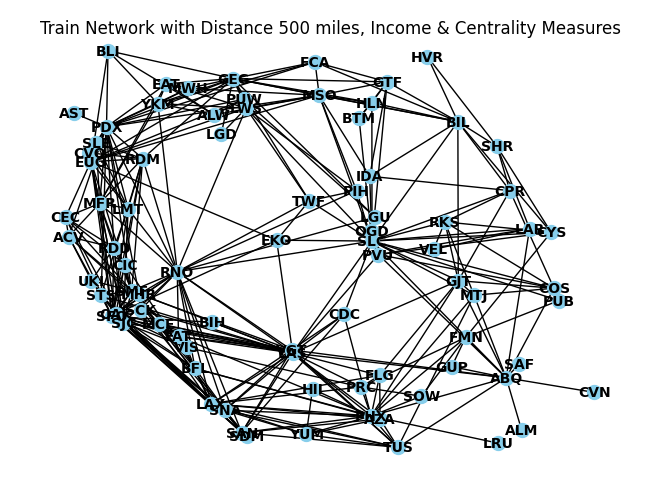

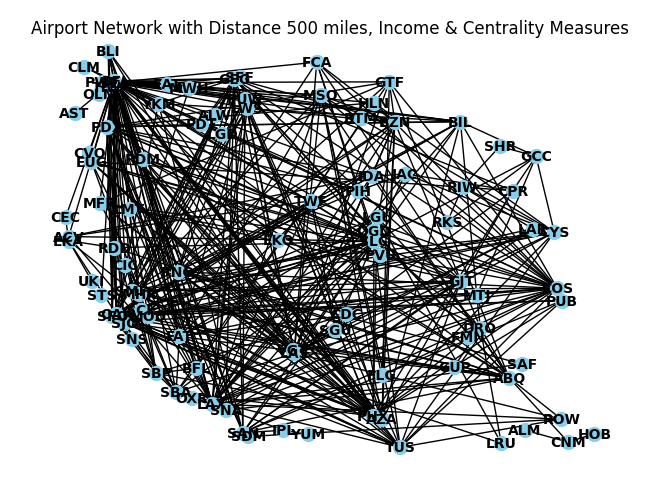

CO2 emissions would be reduced by 27.90356744743898%


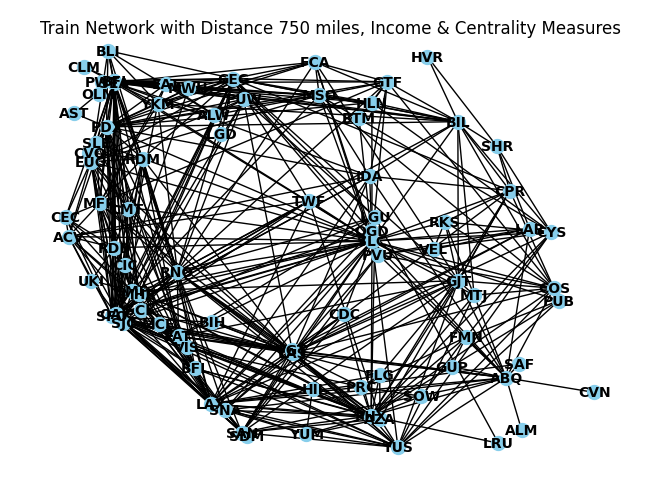

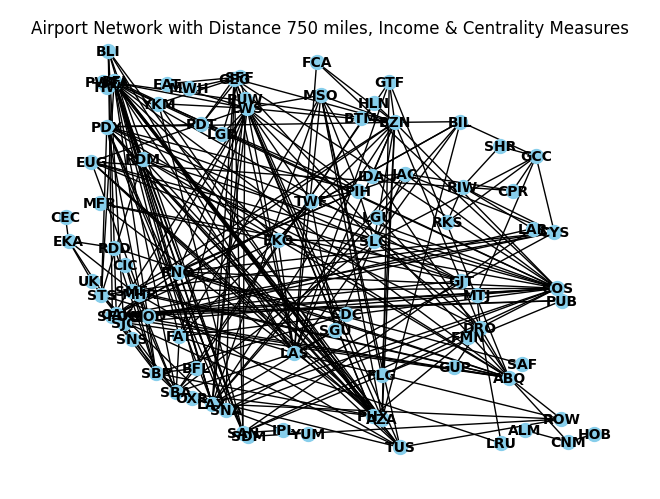

CO2 emissions would be reduced by 54.78205913831976%


In [ ]:
#Closeness Centrality
T1cc = TDist1.copy()
T1cc, x, y = drawNetworkDIC(T1cc, 250, nx.closeness_centrality)
z = (total_weight - (x + y))/total_weight * 100
print("CO2 emissions would be reduced by", str(z) + "%")

T2cc = TDist2.copy()
T2cc, x, y = drawNetworkDIC(T2cc, 500, nx.closeness_centrality)
z = (total_weight - (x + y))/total_weight * 100
print("CO2 emissions would be reduced by", str(z) + "%")

T3cc = TDist3.copy()
T3cc, x, y = drawNetworkDIC(T3cc, 750, nx.closeness_centrality)
z = (total_weight - (x + y))/total_weight * 100
print("CO2 emissions would be reduced by", str(z) + "%")

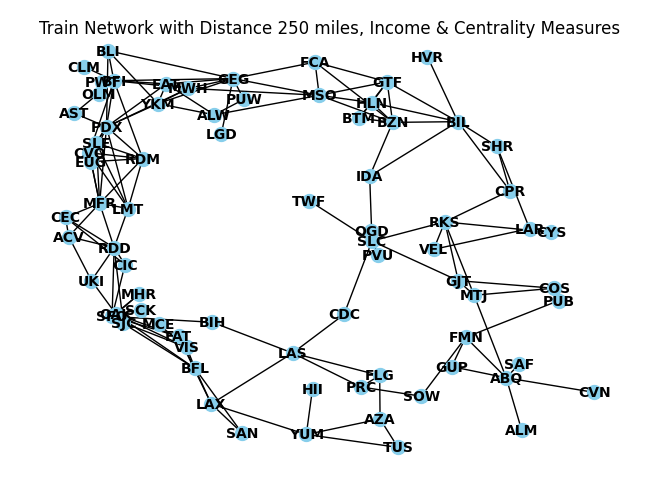

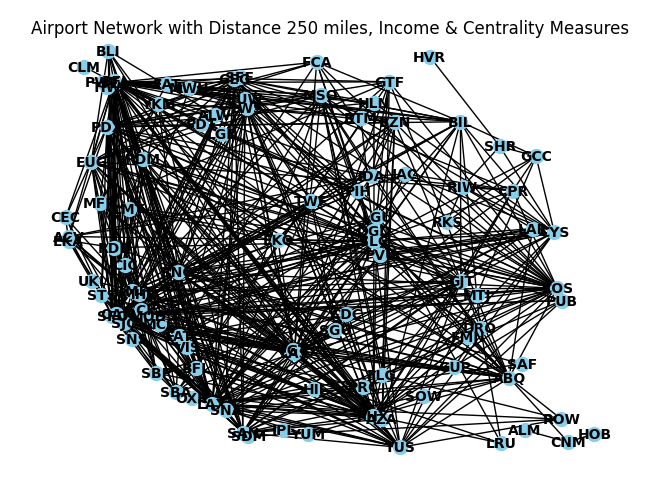

CO2 emissions would be reduced by 1.6219050578382386%


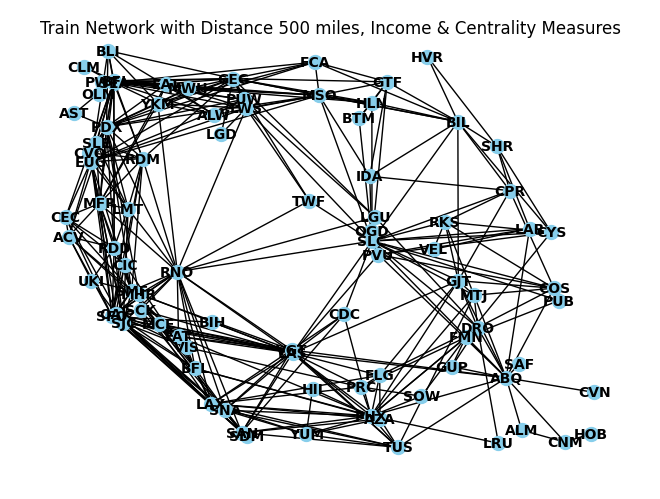

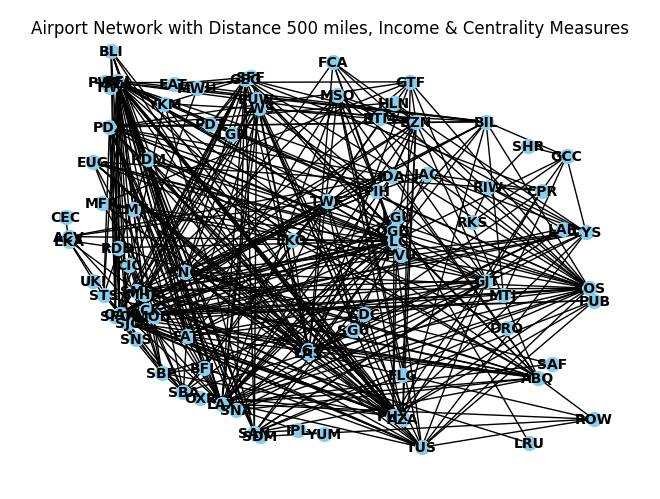

CO2 emissions would be reduced by 29.471629372883623%


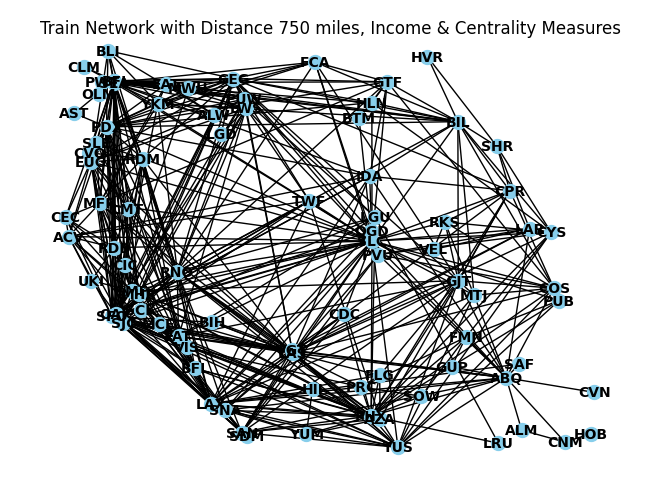

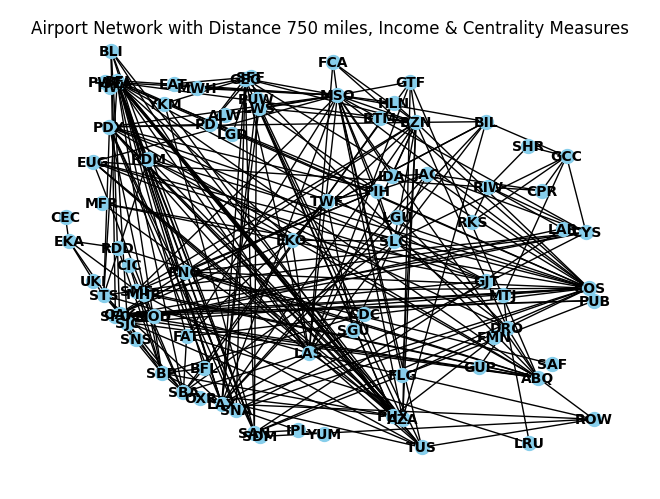

CO2 emissions would be reduced by 53.81144667451646%


In [ ]:
#Betweenness Centrality
T1bc = TDist1.copy()
T1bc, x, y = drawNetworkDIC(T1bc,  250, nx.betweenness_centrality)
z = (total_weight - (x + y))/total_weight * 100
print("CO2 emissions would be reduced by", str(z) + "%")

T2bc = TDist2.copy()
T2bc, x, y = drawNetworkDIC(T2bc, 500, nx.betweenness_centrality)
z = (total_weight - (x + y))/total_weight * 100
print("CO2 emissions would be reduced by", str(z) + "%")

T3bc = TDist3.copy()
T3bc, x, y = drawNetworkDIC(T3bc, 750, nx.betweenness_centrality)
z = (total_weight - (x + y))/total_weight * 100
print("CO2 emissions would be reduced by", str(z) + "%")

#### Train Structural Cost

Threshold of distance is set at 500 miles since CO2 emission reduction is significantly better than for distance threshold 250 and 750 miles. PageRank, Closeness, Betweenness centrality with the third quartile of the centrality measures are used as the threshold.

In [ ]:
def drawNetworkDistance(threshold):
  traindf = west_df.loc[west_df["Distance"] < threshold]
  trains = set(pd.concat([traindf["Origin_airport"], traindf["Destination_airport"]]))
  TDist = nx.Graph()
  TDist.add_nodes_from(trains)

  for index, row in traindf.iterrows():
    origin_airport = row['Origin_airport']
    latitude = row['Org_airport_lat']
    longitude = row['Org_airport_long']
    TDist.nodes[origin_airport]['latitude'] = latitude
    TDist.nodes[origin_airport]['longitude'] = longitude

    destination_airport = row['Destination_airport']
    latitude = row['Dest_airport_lat']
    longitude = row['Dest_airport_long']
    TDist.nodes[destination_airport]['latitude'] = latitude
    TDist.nodes[destination_airport]['longitude'] = longitude

    cost = 323 #in million USD
    dist_miles = row["Distance"]
    TDist.add_edge(origin_airport, destination_airport, weight = dist_miles * cost)

  pos = {node: (TDist.nodes[node]['longitude'], TDist.nodes[node]['latitude']) for node in TDist.nodes}
  nx.draw(TDist, pos, with_labels=True, node_size=100, node_color='skyblue', font_size=10, font_color='black', font_weight='bold')
  plt.suptitle("Train Network for Cities with Distance < " + str(threshold) + " Miles")
  plt.show()

  ADist = G.copy()
  for i in list(TDist.edges()):
    ADist.remove_edge(*i)
  isolates = list(nx.isolates(ADist))
  ADist.remove_nodes_from(isolates)
  pos = {node: (ADist.nodes[node]['longitude'], ADist.nodes[node]['latitude']) for node in ADist.nodes}
  nx.draw(ADist, pos, with_labels=True, node_size=100, node_color='skyblue', font_size=10, font_color='black', font_weight='bold')
  plt.suptitle("Airport Network for Cities with Distance >= " + str(threshold) + " Miles")
  plt.show()

  x = sum(data['weight'] for _, _, data in TDist.edges(data=True))
  return TDist, ADist, x

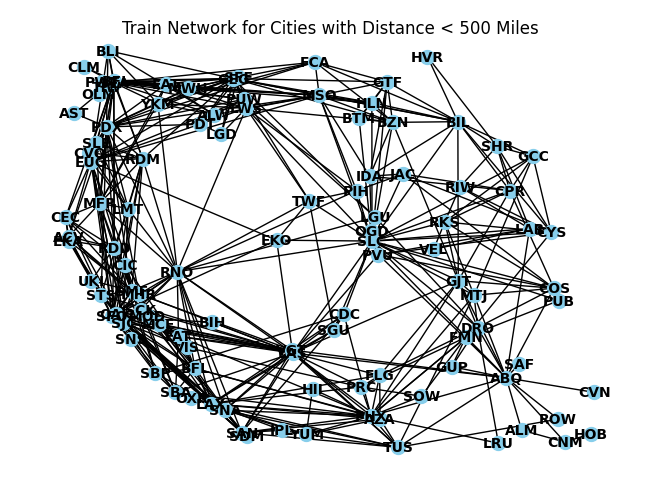

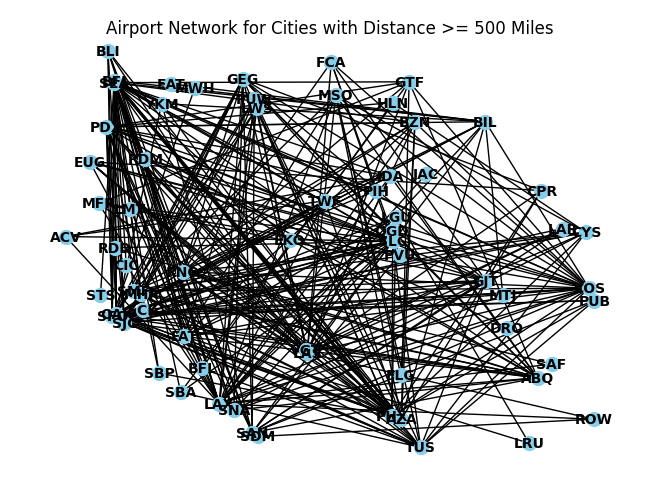

Structural Cost for Train Network: 35145630


In [ ]:
TD, AD, train_cost = drawNetworkDistance(500)
print("Structural Cost for Train Network:", train_cost)

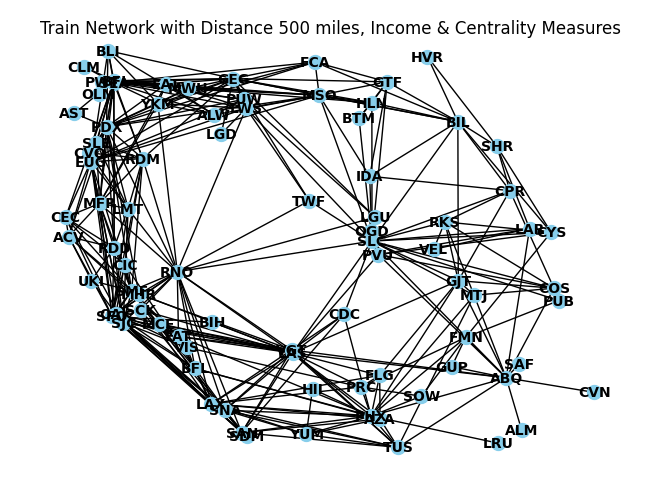

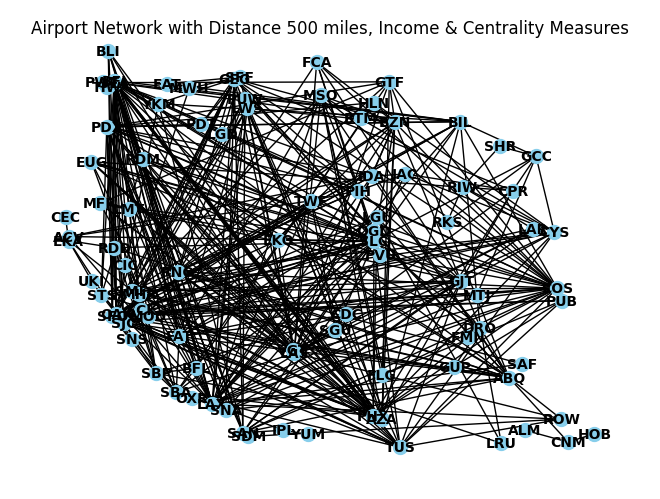

Structural Cost for Train Network with PageRank Centrality: 27862303


In [ ]:
#PageRank Centrality
PC = TD.copy()
PC, PC_cost, y = drawNetworkDIC(PC, 500, nx.pagerank)
print("Structural Cost for Train Network with PageRank Centrality:", PC_cost)

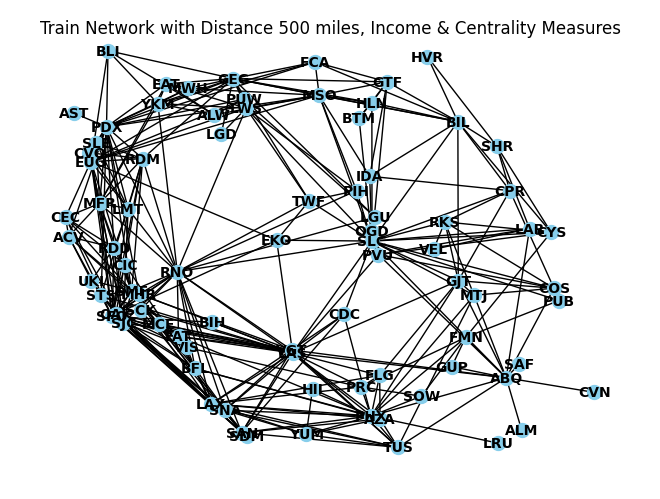

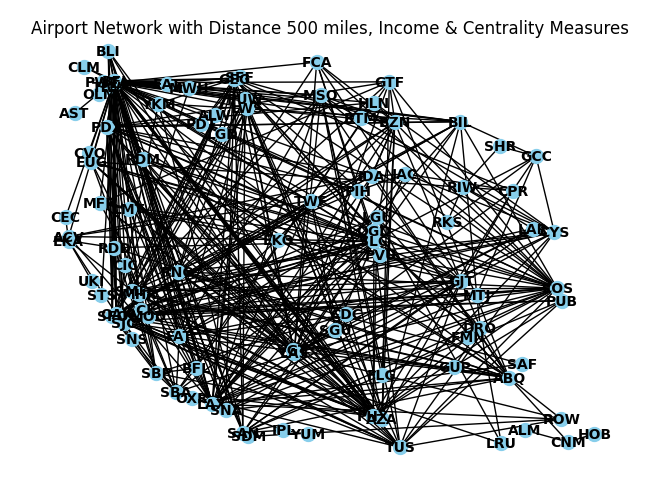

Structural Cost for Train Network with Closeness Centrality: 26961133


In [ ]:
#Closeness Centrality
CC = TD.copy()
CC, CC_cost, y = drawNetworkDIC(CC, 500, nx.closeness_centrality)
print("Structural Cost for Train Network with Closeness Centrality:", CC_cost)

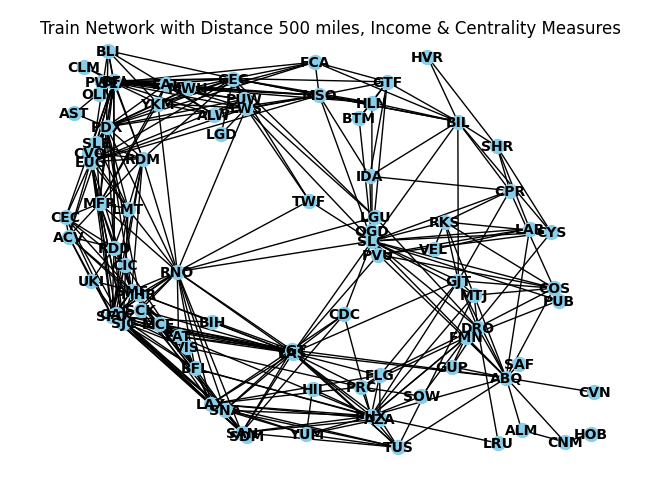

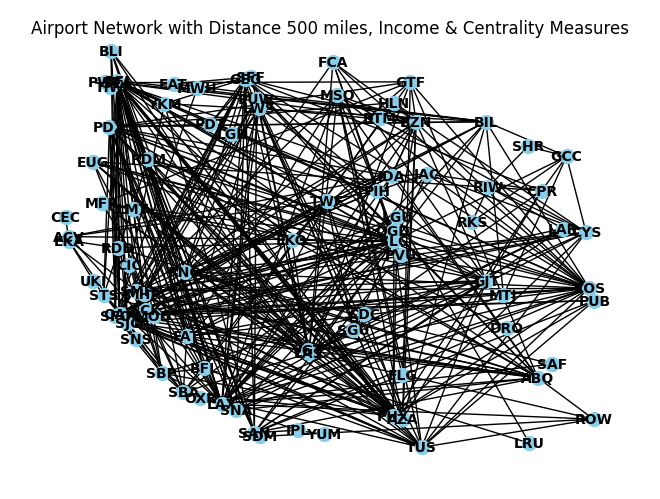

Structural Cost for Train Network with Betweenness Centrality: 28779300


In [ ]:
#Betweeness Centrality
BC = TD.copy()
BC, BC_cost, y = drawNetworkDIC(BC, 500, nx.betweenness_centrality)
print("Structural Cost for Train Network with Betweenness Centrality:", BC_cost)

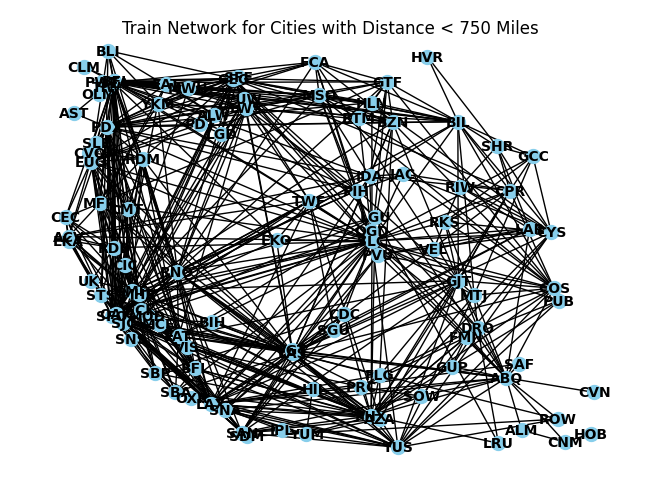

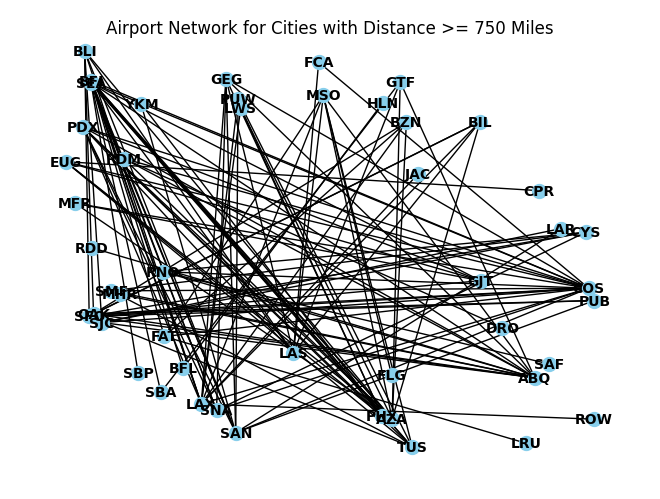

Structural Cost for Train Network: 68586466


In [ ]:
TD, AD, train_cost = drawNetworkDistance(750)
print("Structural Cost for Train Network:", train_cost)

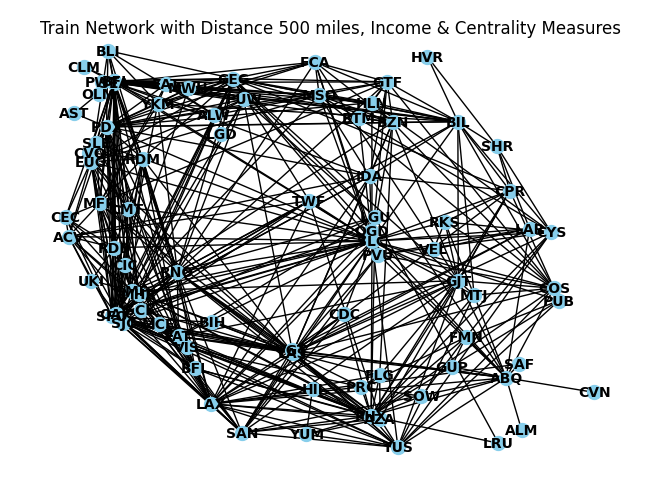

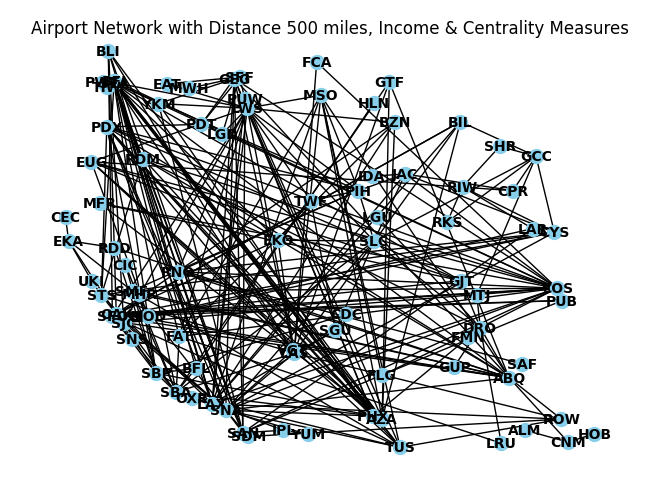

Structural Cost for Train Network with PageRank Centrality: 56614471


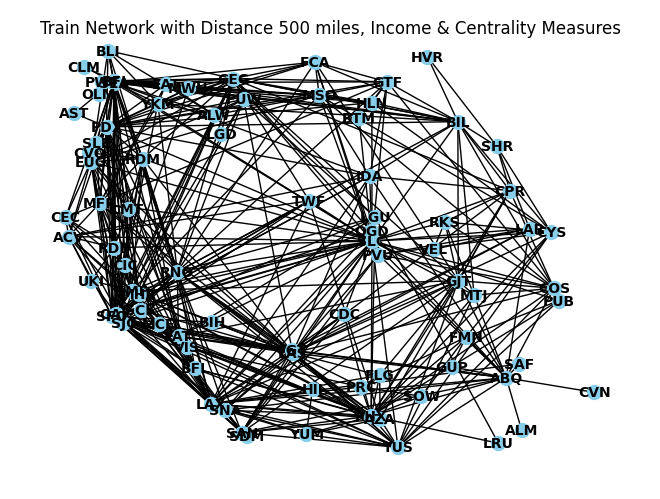

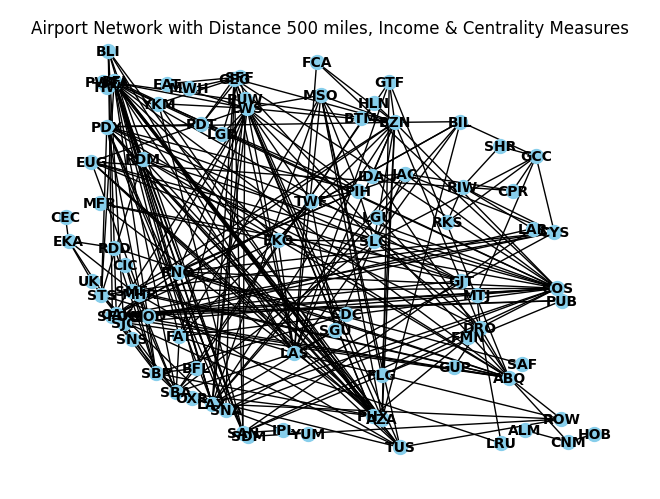

Structural Cost for Train Network with Closeness Centrality: 56239145


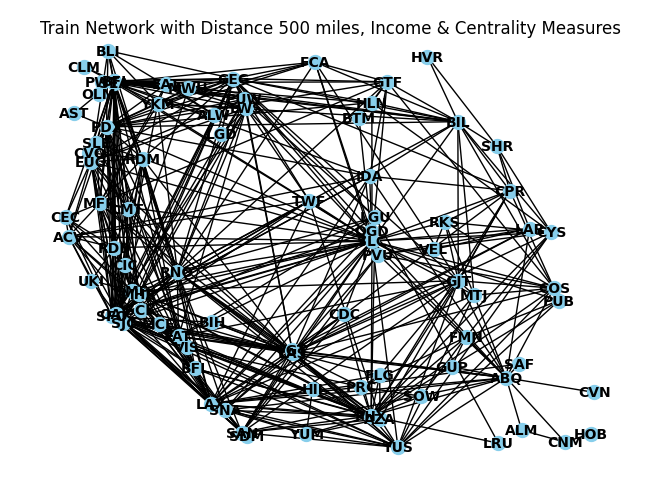

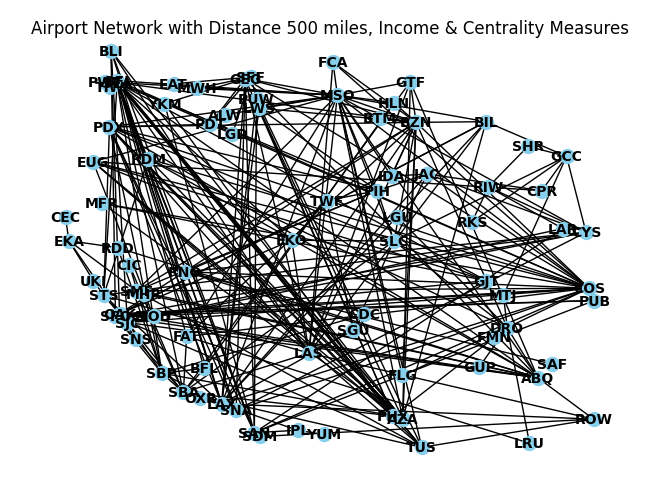

Structural Cost for Train Network with Betweenness Centrality: 56205230


In [ ]:
#PageRank Centrality
PC = TD.copy()
PC, PC_cost, y = drawNetworkDIC(PC, 500, nx.pagerank)
print("Structural Cost for Train Network with PageRank Centrality:", PC_cost)

#Closeness Centrality
CC = TD.copy()
CC, CC_cost, y = drawNetworkDIC(CC, 500, nx.closeness_centrality)
print("Structural Cost for Train Network with Closeness Centrality:", CC_cost)

#Betweeness Centrality
BC = TD.copy()
BC, BC_cost, y = drawNetworkDIC(BC, 500, nx.betweenness_centrality)
print("Structural Cost for Train Network with Betweenness Centrality:", BC_cost)

#### Analysis of Economic and Enviromental Costs with the use of Decision making

Now passangers will be able to choose whether to fly or take the train based off of the cost of each, how long each takes, and their own income.

In [ ]:
airport_coordinates_df = west_df[['Destination_airport','Dest_airport_lat', 'Dest_airport_long']].copy()
coordinates_df = airport_coordinates_df.drop_duplicates()
airport_coordinates_dfb = west_df[['Origin_airport','Org_airport_lat', 'Org_airport_long']].copy()
coordinates_dfb = airport_coordinates_dfb.drop_duplicates()
coordinates_dfb = coordinates_dfb.set_axis(['Destination_airport','Dest_airport_lat', 'Dest_airport_long'],axis='columns')
union_dfs = pd.concat([coordinates_dfb, coordinates_df], ignore_index=True)
union_dfs = union_dfs.drop_duplicates()
union_dfs= union_dfs.set_index('Destination_airport')
display(union_dfs)

,Dest_airport_lat,Dest_airport_long
Destination_airport,,
ABQ,35.040199,-106.609001
ACV,40.978100,-124.109001
ALM,32.839901,-105.990997
ALW,46.094898,-118.288002
AST,46.158001,-123.878998
...,...,...
VIS,36.318699,-119.392998
YKM,46.568199,-120.543999
YUM,32.656601,-114.606003


In [ ]:
from geopy.distance import geodesic as GD

def ellipsoidal_distance (p1,p2) -> float:
    return GD(p1,p2).km

def compute_distance_matrix(coordinates_df, dist_metric= ellipsoidal_distance):
  df_dist_matrix = pd.DataFrame(index=coordinates_df.index,
                                     columns=coordinates_df.index)
  for orig, orig_loc in coordinates_df.iterrows():  #for each origin
    for dest, dest_loc in coordinates_df.iterrows():  #for each destination
      df_dist_matrix.at[orig, dest] = dist_metric(orig_loc, dest_loc)
  return df_dist_matrix

west_df_distances = compute_distance_matrix(union_dfs)


display(west_df_distances)

Destination_airport,ABQ,ACV,ALM,ALW,AST,AZA,BFI,BFL,BIH,BIL,...,TUS,TWF,UKI,VEL,VGT,VIS,YKM,YUM,PWT,SNS
Destination_airport,,,,,,,,,,,,,,,,,,,,,
ABQ,0.0,1668.349967,250.656503,1572.869041,1905.936482,503.264499,1903.903889,1133.161425,1087.520895,1206.766228,...,516.555658,1072.004079,1540.770672,651.583012,788.190104,1165.086236,1733.069283,785.623039,1927.539135,1365.190325
ACV,1668.349967,0.0,1844.724229,737.50709,575.806106,1393.617233,742.134716,757.679232,637.417937,1367.590518,...,1532.206987,817.221474,219.75648,1233.670632,939.037182,660.128996,684.027393,1252.097623,731.494129,525.996013
ALM,250.656503,1844.724229,0.0,1807.914416,2124.487493,531.350262,2133.424731,1237.98673,1233.744296,1456.224362,...,472.123075,1305.089162,1697.890303,900.066571,923.454466,1287.504679,1963.327067,807.410869,2155.693682,1489.32815
ALW,1572.869041,737.50709,1807.914416,0.0,432.077055,1528.077638,345.345258,1185.697936,968.736503,755.742185,...,1675.126995,503.035861,872.384531,948.926181,1127.768676,1089.644555,181.494874,1524.865669,375.289403,1083.418153
AST,1905.936482,575.806106,2124.487493,432.077055,0.0,1765.744808,194.238948,1257.917804,1077.443692,1187.134811,...,1913.267687,852.493762,783.12389,1324.909222,1321.564484,1155.13113,260.642997,1695.663989,170.753815,1071.415806
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
VIS,1165.086236,660.128996,1287.504679,1089.644555,1155.13113,782.48745,1268.173545,102.787714,148.708364,1391.012624,...,907.148468,803.825014,457.948742,976.452155,377.488425,0.0,1142.359422,598.477302,1271.654035,201.92716
YKM,1733.069283,684.027393,1963.327067,181.494874,260.642997,1654.253995,171.099556,1242.794141,1037.07183,929.423992,...,1802.264231,661.421573,854.663953,1120.578098,1233.523555,1142.359422,0.0,1625.341368,197.495927,1103.680009
YUM,785.623039,1252.097623,807.410869,1524.865669,1695.663989,285.122051,1774.914569,513.507671,625.51086,1549.857276,...,350.008013,1090.539136,1056.145887,976.458361,397.941736,598.477302,1625.341368,0.0,1785.617021,780.164256


In [ ]:
#Making Income distribution
incomes=np.zeros(999)
for i in range(0,83):
  incomes[i]=5000+i*10000/83
for i in range(83,157):
  incomes[i]=15000+(i-83)*10000/74
for i in range(157,233):
  incomes[i]=25000+(i-157)*10000/76
for i in range(233,339):
  incomes[i]=35000+(i-233)*15000/106
for i in range(339,501):
  incomes[i]=50000+(i-339)*25000/162
for i in range(501,624):
  incomes[i]=75000+(i-501)*25000/123
for i in range(624,788):
  incomes[i]=100000+(i-624)*50000/194
for i in range(788,880):
  incomes[i]=150000+(i-788)*50000/92
for i in range(880,999):
  incomes[i]=200000+(i-880)*50000/119

AvIncome=0
for i in range(0,999):
  AvIncome=AvIncome+incomes[i]
AvIncome=AvIncome/999
print(AvIncome)
AvIncome=92698

#Defining and preparing constants for the definitions and graphs below
BarrierIncome=0
TrainFare=91
PlaneFare=154
PlanePol=246 #grams of CO2-equivalents per kilometer per passenger
TrainPol=35 #grams of CO2-equivalents per kilometer per passenger
TrainSpeed=325 #km/h
PlaneSpeed=839 #km/h Crusing
PlaneTOSpeed=245 #km/h take off speed, linearlly increases to 865 with time
PlaneTOTime=1/3 #h spent getting to cruising speed
PlaneTODist=185 #km covered before cruising ((865+245)/2)*1/3
PlaneLSpeed=241 #km/h speed of landing
PlaneLTime=0.5 #h spent landing
PlaneLDist=120.5 #km covered before landing
PlaneBTime=2/3 #h boarding time

92697.54290372846


In [ ]:
#Function that takes in a Airplane and Train Network and returns the total fares and emissions based off of the decisions made by travellers
#Also returns the frac of travellers that take the plane over the train
def PolnFare (G, T):
  TotalPol=0;
  TotalFare=0;
  TotalTrainTakers=0;
  TotalPlaneTakers=0;
  for i in G.nodes():
    for j in G.nodes():
      if G.has_edge(i,j) and T.has_edge(i,j):
        distance=west_df_distances[i][j]
        TrainTime=1.2*distance/TrainSpeed #1.2 taking in account the that the rail likely isnt a straight shot
        if distance >= PlaneTODist+PlaneLDist:
          PlaneTime=PlaneTOTime+PlaneLTime+PlaneBTime
          PlaneTime=PlaneTime+(distance-PlaneTODist-PlaneLDist)/PlaneSpeed
        if distance < PlaneTODist+PlaneLDist:
          PlaneTime=PlaneBTime+3*distance/(PlaneTOSpeed+PlaneSpeed+PlaneLSpeed)
        if TrainTime!=PlaneTime:
          BarrierIncome=AvIncome*(PlaneFare-TrainFare)/(19.22*(TrainTime-PlaneTime))
        if TrainTime==PlaneTime:
          BarrierIncome=10000000000000; #always take train when they are the same time
        TrainTakersPercentage=0
        for k in range(0,999):
          if incomes[k] <= BarrierIncome:
            TrainTakersPercentage=TrainTakersPercentage+1;
        TrainTakersPercentage=TrainTakersPercentage/999
        TrainTakers=G[i][j]["weight"]*TrainTakersPercentage/246
        PlaneTakers=G[i][j]["weight"]/246-TrainTakers
        TotalFare=TotalFare+TrainTakers*TrainFare+PlaneTakers*PlaneFare;
        TotalPol=TotalPol+TrainTakers*1.2*distance*TrainPol+PlaneTakers*distance*PlanePol;
        TotalTrainTakers=TotalTrainTakers+TrainTakers
        TotalPlaneTakers=TotalPlaneTakers+PlaneTakers
      if G.has_edge(i,j):
        if not T.has_edge(i,j):
          distance=west_df_distances[i][j]
          TotalFare=TotalFare+G[i][j]["weight"]*PlaneFare/246;
          TotalPol=TotalPol+G[i][j]["weight"]*distance*PlanePol/246;
          TotalPlaneTakers=TotalPlaneTakers+G[i][j]["weight"]/246
  TotalPlaneTakersFrac=TotalPlaneTakers/(TotalTrainTakers+TotalPlaneTakers)
  return [TotalFare,TotalPol,TotalPlaneTakersFrac]

In [ ]:
#A function that estimates the cost of production of a train network
def TrainNetCost(T):
  TrainNCost=0;
  for i in T.nodes():
    for j in T.nodes():
      distance=west_df_distances[i][j]
      if T.has_edge(i,j) and T.has_edge(j,i):
        TrainNCost=TrainNCost+1.13*(distance*1546875)/2 #half cause it gets added twice. 1.13 for inflation
      if T.has_edge(i,j) and not T.has_edge(j,i):
        TrainNCost=TrainNCost+1.13*(distance*1065625)
    return TrainNCost

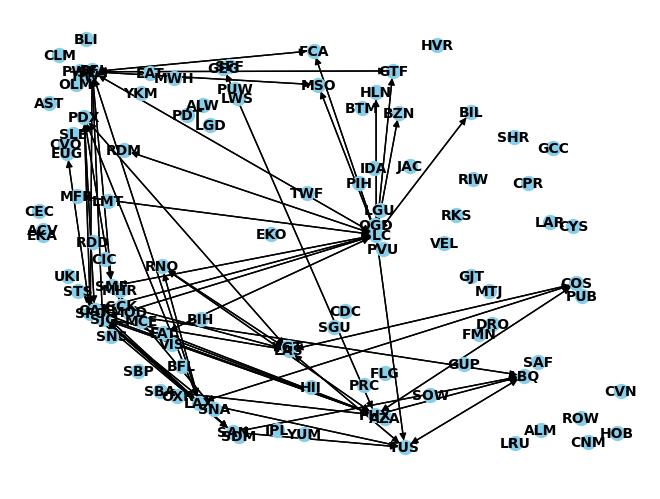

In [ ]:
#Produces a train network in which the construciton of every track can be repayed after k years using only ticket fares
#In this case, k is 5
TMax=nx.DiGraph();
airports = set(pd.concat([west_df["Origin_airport"], west_df["Destination_airport"]]))

TMax.add_nodes_from(airports)

for index, row in west_df.iterrows():
    origin_airport = row['Origin_airport']
    latitude = row['Org_airport_lat']
    longitude = row['Org_airport_long']
    TMax.nodes[origin_airport]['latitude'] = latitude
    TMax.nodes[origin_airport]['longitude'] = longitude

for index, row in west_df.iterrows():
    destination_airport = row['Destination_airport']
    latitude = row['Dest_airport_lat']
    longitude = row['Dest_airport_long']
    TMax.nodes[destination_airport]['latitude'] = latitude
    TMax.nodes[destination_airport]['longitude'] = longitude

for i in G.nodes():
  for j in G.nodes():
    if G.has_edge(i,j) and G.has_edge(j,i):
      distance=west_df_distances[i][j]
      TrainTime=1.2*distance/TrainSpeed
      if distance >= PlaneTODist+PlaneLDist:
        PlaneTime=PlaneTOTime+PlaneLTime+PlaneBTime
        PlaneTime=PlaneTime+(distance-PlaneTODist-PlaneLDist)/PlaneSpeed
      if distance < PlaneTODist+PlaneLDist:
        PlaneTime=PlaneBTime+3*distance/(PlaneTOSpeed+PlaneSpeed+PlaneLSpeed)
      if TrainTime!=PlaneTime:
        BarrierIncome=AvIncome*(PlaneFare-TrainFare)/(19.22*(TrainTime-PlaneTime))
      if TrainTime==PlaneTime:
        BarrierIncome=10000000000000; #always take train when they are the same time
      TrainTakersPercentage=0
      for k in range(0,999):
        if incomes[k] <= BarrierIncome:
          TrainTakersPercentage=TrainTakersPercentage+1;
      TrainTakersPercentage=TrainTakersPercentage/999
      TrainTakers1=G[i][j]["weight"]*TrainTakersPercentage/246
      TrainTakers2=G[j][i]["weight"]*TrainTakersPercentage/246
      TotalTrainFare=(TrainTakers1+TrainTakers2)*TrainFare;
      TrainNCost=1.13*(distance*1546875)*1.2
      k=5;
      if k*TotalTrainFare >= TrainNCost:
        TMax.add_edge(i,j)
        TMax.add_edge(j,i)
    if G.has_edge(i,j) and not G.has_edge(j,i):
      distance=west_df_distances[i][j]
      TrainTime=1.2*distance/TrainSpeed
      if distance >= PlaneTODist+PlaneLDist:
        PlaneTime=PlaneTOTime+PlaneLTime+PlaneBTime
        PlaneTime=PlaneTime+(distance-PlaneTODist-PlaneLDist)/PlaneSpeed
      if distance < PlaneTODist+PlaneLDist:
        PlaneTime=PlaneBTime+3*distance/(PlaneTOSpeed+PlaneSpeed+PlaneLSpeed)
      if TrainTime!=PlaneTime:
        BarrierIncome=AvIncome*(PlaneFare-TrainFare)/(19.22*(TrainTime-PlaneTime))
      if TrainTime==PlaneTime:
        BarrierIncome=10000000000000; #always take train when they are the same time
      TrainTakersPercentage=0
      for k in range(0,999):
        if incomes[k] <= BarrierIncome:
          TrainTakersPercentage=TrainTakersPercentage+1;
      TrainTakersPercentage=TrainTakersPercentage/999
      TrainTakers1=G[i][j]["weight"]*TrainTakersPercentage/246
      TotalTrainFare=(TrainTakers1)*TrainFare;
      TrainNCost=1.13*(distance*1065625)*1.2
      k=5;
      if k*TotalTrainFare >= TrainNCost:
        TMax.add_edge(i,j)

pos = {node: (TMax.nodes[node]['longitude'], TMax.nodes[node]['latitude']) for node in G.nodes}
nx.draw(TMax, pos, with_labels=True, node_size=100, node_color='skyblue', font_size=10, font_color='black', font_weight='bold')
plt.show()

In [ ]:
print(TrainNetCost(TMax))
print(PolnFare(G,TMax))
print(TrainNetCost(TD)) #Distance
print(PolnFare(G,TD))
print(TrainNetCost(T2)) #Pagerank
print(PolnFare(G,T2))
print(TrainNetCost(T2cc)) #Closeness
print(PolnFare(G,T2cc))
print(TrainNetCost(T2bc)) #Betweenness
print(PolnFare(G,T2bc))
print(TrainNetCost(PC)) #Pagerank with Distance
print(PolnFare(G,PC))

1880193309.5238838
[109698379096.41805, 131928259840848.84, 0.4757600700700948]
20097758505.639557
[105422130136.39894, 130155025895002.81, 0.4009068896871893]
9788724886.56069
[123231941035.66705, 185977002917538.78, 0.7126569772738643]
10409672809.08493
[124598663223.34903, 188737222837746.8, 0.7365806317206414]
9788724886.56069
[123884869482.74927, 187278417148761.94, 0.7240860992177749]
18197125158.36618
[109221452196.40167, 138734696242203.34, 0.46741174993949547]


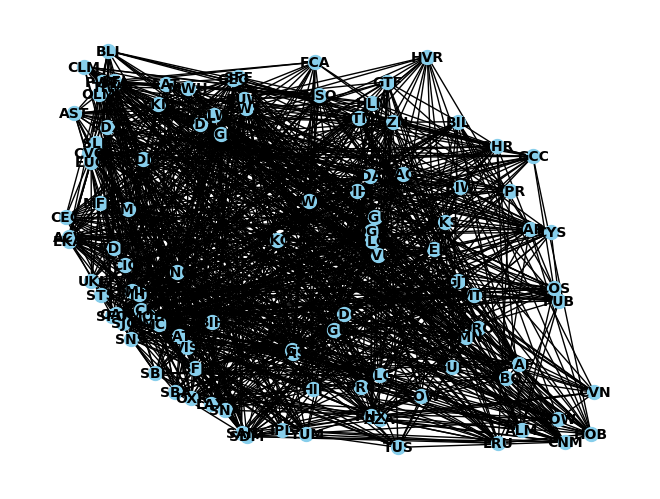

In [ ]:
import random

TRan = nx.Graph()
airports = set(pd.concat([west_df["Origin_airport"], west_df["Destination_airport"]]))

TRan.add_nodes_from(airports)

for index, row in west_df.iterrows():
    origin_airport = row['Origin_airport']
    latitude = row['Org_airport_lat']
    longitude = row['Org_airport_long']
    TRan.nodes[origin_airport]['latitude'] = latitude
    TRan.nodes[origin_airport]['longitude'] = longitude

for index, row in west_df.iterrows():
    destination_airport = row['Destination_airport']
    latitude = row['Dest_airport_lat']
    longitude = row['Dest_airport_long']
    TRan.nodes[destination_airport]['latitude'] = latitude
    TRan.nodes[destination_airport]['longitude'] = longitude

for i in TRan.nodes():
    for j in TRan.nodes():
      n=random.randint(0,9)
      if n==0:
        TRan.add_edge(i, j)

TRan.remove_edges_from(nx.selfloop_edges(TRan))

pos = {node: (TRan.nodes[node]['longitude'], TRan.nodes[node]['latitude']) for node in TRan.nodes}
nx.draw(TRan, pos = pos, with_labels=True, node_size=100, node_color='skyblue', font_size=10, font_color='black', font_weight='bold')
plt.show()

In [ ]:
print(TrainNetCost(TRan))
print(PolnFare(G,TRan)) #Testing TRan. Can see planes are preferable to most people
print(TRan.number_of_edges())
print(TMax.number_of_edges())

13074080787.108292
[134082304225.36804, 203555927404176.3, 0.9025860952116386]
1029
112
